# Assignment 1

**Computer Vision**

Master in Data Science and Engineering - Faculdade de Engenharia da Universidade do Porto


Cátia Teixeira (200808037) |  Miguel Veloso (202202463)



---



## Context

The quality assurance tester of a M&M factory retrieves a sample from the
production every hour to determine some properties of chocolate peanuts. The
factory uses a computer vision application to automatically calculate some
properties of the sample, namely:

• the distribution of each color in the sample, e.g., the number of red (or
blue or …) chocolates. At the end, if the sample does not have chocolate
peanuts of all colors, the system must raise an alarm by printing “Color
XPTO is missing”.

• the average shape area of all chocolate peanuts in millimeters and
organized by color.

Considering these requirements:

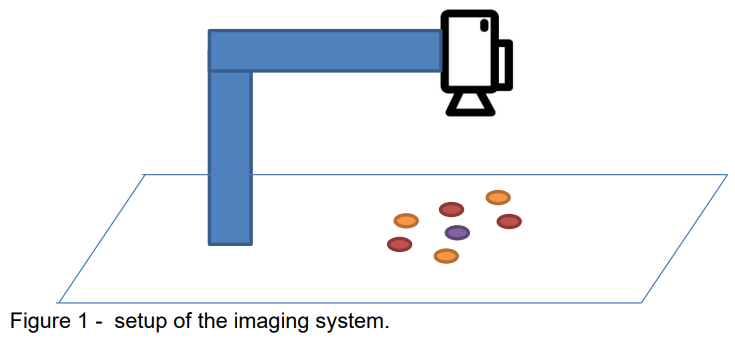

## Introduction

&ensp;For the course of this assignment it is important to understand the meaning and differences between the intrinsic properties of the camera and the extrinsic properties as well as the different coordinate systems involvel in image processing.

* World coordinate system (3D)

> It is a 3D basic cartesian coordinate system with arbitrary origin. A point in this coordinate system can be denoted as Pw = (Xw, Yw, Zw)

* Camera coordinate system (3D)

> 3D coordinate system that measures relative to the object/camera’s origin/orientation.  A point in this coordinate system can be denoted as Pc = (Xc, Yc, Zc)

* Image coordinate system (2D)

> A 2D coordinate system that has the 3D points in the camera coordinate system projected onto a 2D plane. A point in this coordinate system can be denoted as Pi = (Xi, Yi)

* Pixel coordinate system (2D)

> A 2D coordinate system that represents the integer values by discretizing the points in the image coordinate system. A point in this coordinate system can be denoted as Pp = (u, v)

&ensp; Transitioning all the way from world coordinate system up to image plane (3D-2D) is often referred as the **Forward Imaging Model**. Transitioning from world to camera (3D-3D) is called coordinate transformation. Transitioning from camera to image (3D-2D) is calleed perspective projection.

&ensp; Transformation matrices enable for translation of coordinates between different coordinates system.

&ensp;The extrinsic matrix is a transformation matrix from the world coordinate system to the camera coordinate system, while the intrinsic matrix is a transformation matrix that converts points from the camera coordinate system to the pixel coordinate system.

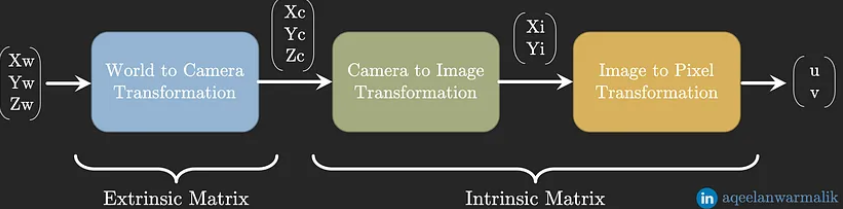

## Import libraries

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
import numpy as np
import pandas as pd
import glob
import webcolors
from tabulate import tabulate
import matplotlib.pyplot as plt
from scipy import ndimage
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
import imutils

from google.colab import drive
drive.mount('/content/gdrive', force_remount = True)

# Any problems accessing the drive, please acess by the follwoing link
# https://drive.google.com/drive/folders/1TqCcjM6Z4_KXemcN2rLJPofqhjfUrjLN?usp=sharing



Mounted at /content/gdrive




---



a) Calibrate the intrinsic parameters and lens distortion of the camera. Show
the intrinsic matrix and the lens distortion coefficients.




---



For a chessboard calibration pattern, we make the following assumptions:

1.   The calibration pattern (chessboard) is flat and lies in the XY plane.
2.   The pattern is positioned at Z=0 in a 3D coordinate system.

With these assumptions, we assign 3D object points as follows:

*   The 3D coordinates for the calibration pattern corners are essentially a grid pattern with rows and columns, where each corner corresponds to a point.
*   The exact values of these coordinates are not as critical as the geometry of the pattern.

This simplification allows to perform camera calibration even when we don't have precise knowledge of the physical world coordinates of the calibration pattern.

In our approach, we will employ the "findChessboardCorners" function, a valuable feature within the OpenCV library, to identify and locate the corners of a chessboard pattern in images.




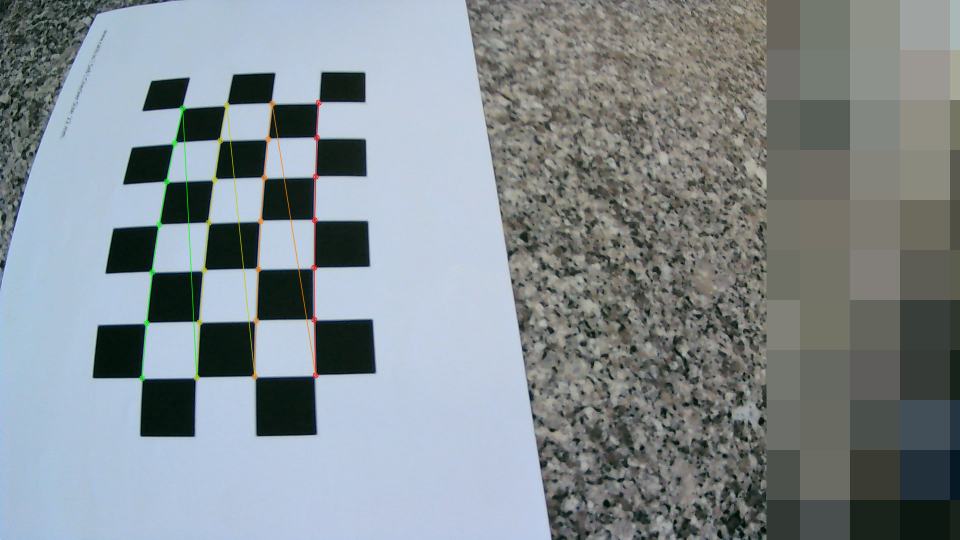

In [ ]:
# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

rows, cols = 7, 4

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((rows * cols,3), np.float32)
objp[:,:2] = np.mgrid[0:rows,0:cols].T.reshape(-1,2)

# Load calibration images and detect corners
images = glob.glob('./gdrive/MyDrive/VC_Assign_1/IntrinsicCalibration/*.png')

for fname in images:
  img = cv.imread(fname)
  gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

  # Find the chess board corners
  ret, corners = cv.findChessboardCorners(gray, (rows,cols), None)

  # If found, add object points, image points (after refining them)
  if ret == True:
    objpoints.append(objp)
    corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
    imgpoints.append(corners2)

    # Draw and display the corners
    cv.drawChessboardCorners(img, (rows,cols), corners2, ret)
    img_prt = cv.resize(img, (960,540))


cv2_imshow(img_prt)


The images above show that the camera calibration was executed precisely and accoringly with the expections. In each image, the chessboard corners were not only successfully detected but also accurately drawn, indicating the robustness and reliability of the corner detection and refinement procedures.

The points are shown below for illustrative purposes.

In [ ]:
# Prepare data for tabulate
data = []

# Check if the lists are different
if objpoints != imgpoints:
    for i in range(min(len(objpoints), len(imgpoints))):
        data.append([f"Set {i + 1}", str(objpoints[i]), str(imgpoints[i])])
    if len(objpoints) > len(imgpoints):
        for i in range(len(imgpoints), len(objpoints)):
            data.append([f"Set {i + 1}", str(objpoints[i]), ""])
else:
    for i in range(len(objpoints)):
        data.append([f"Set {i + 1}", str(objpoints[i]), ""])

# Headers for the table
headers = ["Description", "Object Points", "Image Points"]

# Print the table using tabulate
table = tabulate(data, headers, tablefmt="grid")
print(table)


+---------------+-----------------+-------------------------------+
| Description   | Object Points   | Image Points                  |
+===============+=================+===============================+
| Set 1         | [[0. 0. 0.]     | [[[ 415.87375  304.33286]]    |
|               |  [1. 0. 0.]     |                               |
|               |  [2. 0. 0.]     |  [[ 527.20544  295.73486]]    |
|               |  [3. 0. 0.]     |                               |
|               |  [4. 0. 0.]     |  [[ 645.3732   289.56485]]    |
|               |  [5. 0. 0.]     |                               |
|               |  [6. 0. 0.]     |  [[ 775.84076  286.85803]]    |
|               |  [0. 1. 0.]     |                               |
|               |  [1. 1. 0.]     |  [[ 911.0845   288.18768]]    |
|               |  [2. 1. 0.]     |                               |
|               |  [3. 1. 0.]     |  [[1049.9489   290.16705]]    |
|               |  [4. 1. 0.]     |             

<ipython-input-3-9022699e9771>:5: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if objpoints != imgpoints:


Having calculated Pw and Pi, we have all the necessary elements to use the function calibrateCamera from OpenCV.

This functions returns:

* calibration matrix a.ka.a camera matrix (mtx),



> $
\begin{aligned}
\begin{equation}
calibration\ matrix =
\begin{bmatrix}
fx & 0 & cx\\
0 & fy & cy\\
0 & 0 & 1
\end{bmatrix}
 \\
\end{equation}
\end{aligned}
$

>$
\begin{aligned}
\begin{equation}
instrinsic\ matrix =
\begin{bmatrix}
fx & 0 & cx & 0\\
0 & fy & cy & 0\\
0 & 0 & 1 & 0
\end{bmatrix}
\end{equation}
\end{aligned}
$


>$
\begin{aligned}
\begin{equation}
\ \\
where:\\
\end{equation}
\end{aligned}
$

>$
\begin{aligned}
\begin{equation}
(fx, fy) = focal\ length,
\end{equation}
\end{aligned}
$

>$
\begin{aligned}
\begin{equation}
(cx, cy) =  pixel\ coordinates\ of\ the\ camera\ optical\ center.
\end{equation}
 \\
\end{aligned}
$




* distortion coefficients (dist):


> $
\begin{aligned}
\begin{equation}
[k1, k2, p1, p2, k3]
\end{equation}
 \\
\end{aligned}
$

>$
\begin{aligned}
\begin{equation}
k1,\ k2,\ and\ k3\ = Radial\ distortion\ coefficients\ of\ the\ lens.
\end{equation}
 \\
\end{aligned}
$

>$
\begin{aligned}
\begin{equation}
p1\ and\ p2\ = Tangential\ distortion\ coefficients\ of\ the\ lens.
\end{equation}
 \\
\end{aligned}
$


* rotation vectors (rvecs),
* translation vectors (tvecs). <br><br>







In [ ]:
# Calibrate the camera
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

# Prepare data for tabulate
data = [
    ["Intrinsic matrix (camera matrix):", mtx],
    ["Distortion coefficients:", dist],
]

# Headers for the table
headers = ["Description", "Values"]

# Print the table using tabulate
table = tabulate(data, headers, tablefmt="grid")
print(table)

+-----------------------------------+-------------------------------------------------------------------+
| Description                       | Values                                                            |
+===================================+===================================================================+
| Intrinsic matrix (camera matrix): | [[1.32164961e+03 0.00000000e+00 9.88299668e+02]                   |
|                                   |  [0.00000000e+00 1.32444624e+03 6.42259078e+02]                   |
|                                   |  [0.00000000e+00 0.00000000e+00 1.00000000e+00]]                  |
+-----------------------------------+-------------------------------------------------------------------+
| Distortion coefficients:          | [[-3.44269790e-01  9.00566070e-02  9.45585467e-05 -3.97940161e-04 |
|                                   |   -3.15658830e-03]]                                               |
+-----------------------------------+---------

/usr/local/lib/python3.10/dist-packages/tabulate/__init__.py:108: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  or (len(row) >= 2 and row[1] == SEPARATING_LINE)



$
\begin{aligned}
\begin{equation}
(fx, fy) \approx (1321.65, 1324.44)
\end{equation}
\end{aligned}
$

$
\begin{aligned}
\begin{equation}
(cx, cy) \approx (988.30, 642.26)
\end{equation}
 \\
\end{aligned}
$

$
\begin{aligned}
\begin{equation}
[k1, k2, p1, p2, k3] = [-3.44{\times 10^{-1}},\ 9.00{\times 10^{-2}},\ 9.46{\times 10^{-5}},\ -3.98{\times 10^{41}},\ -3.16{\times 10^{-3}}]
\end{equation}
 \\
\end{aligned}
$




---



b) Calibrate the extrinsic parameters of the camera setup (or instead, use
the extrinsic image to manually measure the dimensions of a black
square of the chessboard in pixels. In this way, you will know the
conversion between pixel to millimeter). Show the extrinsic matrix
(rotation, translation, etc) and/or the conversion ratio between pixel to
millimeter that was used.



---



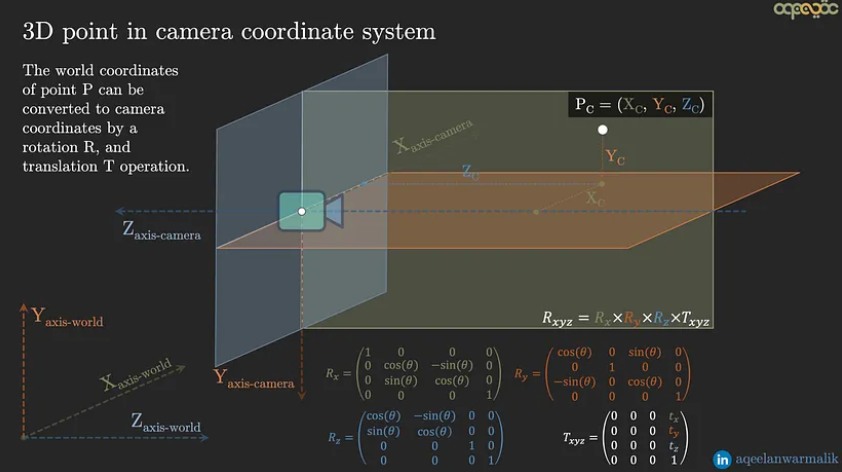

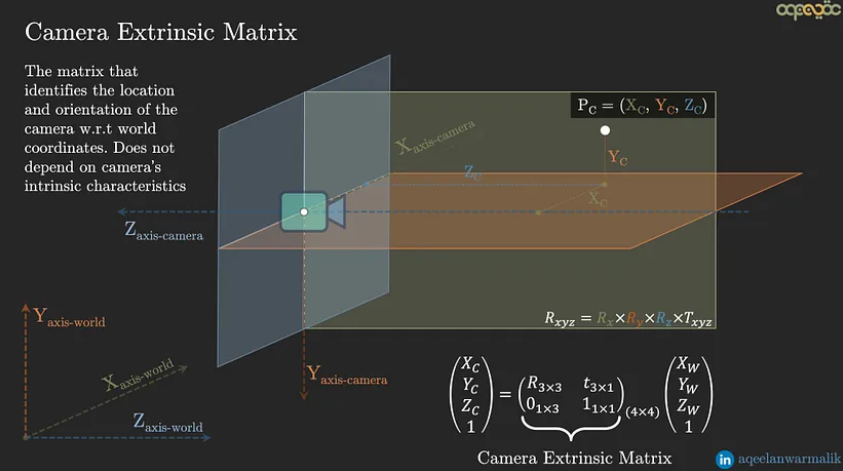

In order to calibrate the extrinsic parameters the following steps were performed:

1. **Rotation and Translation Vectors:** We start by iterating through sets of rotation (rvecs) and translation (tvecs) vectors. These vectors describe the camera's pose concerning the world coordinate system. The primary objective is to convert these vectors into more interpretable formats.

2. **Rotation Matrix:** The rotation vector (rvec) is converted into a rotation matrix (rotation_matrix) using the Rodrigues transformation. This matrix represents the camera's orientation in 3D space.

3. **Extrinsic Parameters:** The extrinsic parameters, which encompass both the rotation and translation matrices, are calculated and stored in the extr_matrix_total list. These matrices define the camera's position and orientation in the world relative to its intrinsic characteristics.

4. **Conversion Ratio:** The conversion ratio, expressing the relationship between pixels and millimeters, is computed. It is often used to convert pixel measurements into real-world dimensions.

In [ ]:
rot_matrix_total = []
extr_matrix_total = []


for i, j in zip(rvecs, tvecs):
    # Convert rotation vector (rvec) to rotation matrix
    rotation_matrix, _ = cv.Rodrigues(np.array(i))

    # Extrinsic parameters (rotation and translation matrices)
    extrinsic_matrix = np.column_stack((rotation_matrix, j))

    rot_matrix_total.append(rotation_matrix)
    extr_matrix_total.append(extrinsic_matrix)


# Prepare the data for tabulate
table_data = []

for extrinsic_matrix  in extr_matrix_total:
    extrinsic_matrix_str = "\n".join(" ".join(map(str, row)) for row in extrinsic_matrix)
    table_data.append([extrinsic_matrix_str])

# Headers for the table
headers = ["Extrinsic Matrix (Rotation & Translation)"]

# Print the table using tabulate
table = tabulate(table_data, headers, tablefmt="grid")
print(table)

+------------------------------------------------------------------------------------+
| Extrinsic Matrix (Rotation & Translation)                                          |
+====================================================================================+
| 0.9983320049729453 -0.0519068246324166 0.025276261655526724 -4.547356335714955     |
| 0.03126967131867323 0.8541697420910641 0.5190532336395826 -2.683852752851059       |
| -0.048532623072746084 -0.517397075032962 0.8543681005544473 9.476549728639817      |
+------------------------------------------------------------------------------------+
| 0.9992807569998953 -0.0378340777129242 0.002559541624692373 -4.041759418982199     |
| 0.03778552418678541 0.999142697094569 0.016915229957644724 -1.8113822385019225     |
| -0.0031973194469705033 -0.016806350174935626 0.9998536511620846 14.840779965091935 |
+------------------------------------------------------------------------------------+
| 0.9307142026086649 -0.1970309785462807 0.

Above we can see the extrinsic matrix for ilustrative purposes for each of the calibration images.

###**Image Undistortion, Chessboard Corner Detection, Extrinsic Matrix and Image to Pixel translation**

1. **Undistorting the Image:**
We employ camera calibration parameters (intrinsic matrix 'mtx' and distortion coefficients 'dist') to undistort the loaded image. Undistortion is essential for ensuring that object sizes and shapes are accurately represented in the image. The 'getOptimalNewCameraMatrix' function is used to determine a new camera matrix, which minimizes distortion, and the 'undistort' function is applied to produce an undistorted image. A region of interest (ROI) is also defined for the undistorted image.

2. **Visualizing the Original and Undistorted Images:**
We provide a visual representation of the original and undistorted images. These two images are displayed side by side for a direct comparison.

3. **Chessboard Corner Detection:**
We take the undistorted image, resizing it for consistency, to convert it to grayscale. Grayscale is commonly used for feature detection. We aim to locate the corners of a chessboard pattern within the image. These corners serve as critical landmarks for calibrating the camera and are fundamental to estimating parameters such as pixel-to-millimeter conversion.

4. **Calculating Pixel-to-Millimeter Ratio:**
After successfully detecting the chessboard corners, we calculate the pixel-to-millimeter ratio by measuring the distances between these corners. By comparing the pixel distances with the actual physical distances (using the known square size), we derive a conversion factor that enables subsequent measurements in the image to be translated into real-world units.

5. **Displaying the Extrinsic Matrix:**
The pixel-to-millimeter ratio is a key output, and it helps bridge the gap between the image and the real world. Additionally, we provide the extrinsic matrix, indicating the transformation from the image plane to a 3D world coordinate system.

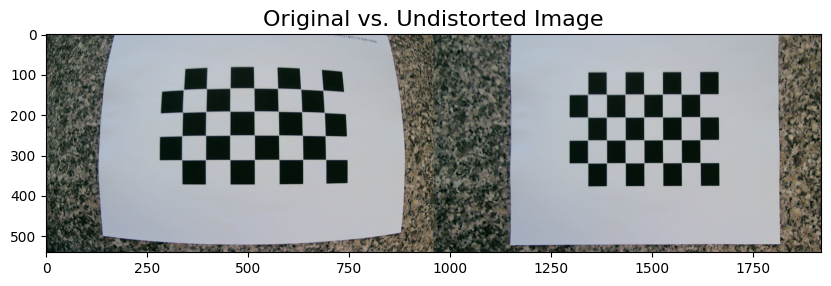

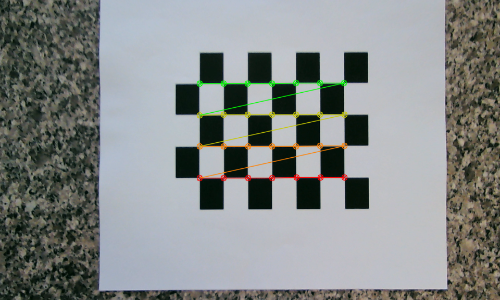

Each millimiter has 3.8216 pixels.
Each pixel has 0.2617 mm.
Extrinsic matrix = 
 [[-9.99992622e-01 -3.52249157e-03 -1.53263249e-03  3.38042499e+00]
 [ 3.49173564e-03 -9.99801266e-01  1.96274408e-02 -1.61350522e-01]
 [-1.60146540e-03  1.96219445e-02  9.99806189e-01  1.08068118e+01]]


In [ ]:
# Load the distorted image
distorted_image = glob.glob('/content/gdrive/MyDrive/VC_Assign_1/WhiteBackground/extrinsic.png')

undistorted_image_total =[]
image_roi_total = []


# Define a single title for all the images
composite_title = "Original vs. Undistorted Image"

for fname in distorted_image:
  img = cv.imread(fname)

  height, width, channels = img.shape

  newcameramatrix, roi = cv.getOptimalNewCameraMatrix(mtx, dist,
   (width, height), 1, (width, height))  # PODEMOS MUDAR ALPHA ENTRE 0 E 1 PARA VARIAR O CROP

  # Undistort the image
  undistorted_image = cv.undistort(img, mtx, dist, None, newcameramatrix)

  x, y, w, h = roi
  image_roi = undistorted_image[y:y+h, x:x+w]

  undistorted_image_total.append(undistorted_image)
  image_roi_total.append(image_roi)

  image_roi_resize = cv.resize(image_roi, (960,540))
  original_resize = cv.resize(img, (960,540))

  # Create a composite image by placing the original and undistorted images side by side
  composite_image = np.hstack((original_resize, image_roi_resize))

  plt.figure(figsize=(10,10))
  plt.imshow(cv.cvtColor(composite_image, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
  plt.title(composite_title, fontsize=16)
  plt.axis('On')  # Turn off axis labels
  plt.show()


# Convert undistorted image to grayscale for corner detection
gray_img = cv.cvtColor(image_roi_resize, cv.COLOR_BGR2GRAY)

# Find the chessboard corners
chessboard_w, chessboard_h = 7, 4
ret, corners = cv.findChessboardCorners(gray_img, (chessboard_w, chessboard_h), None)


# Adjust position of corners according to precision criteria previously indicated
corners = cv.cornerSubPix(gray_img, corners, (11, 11), (-1, -1), criteria)

# List to store the Euclidean distance between each pair of points
distances = []

# Iterate through the detected chessboard corners
corner_mtx = corners.reshape(chessboard_w, chessboard_h, -1)
for row in corner_mtx:
    for corner_l, corner_r in zip(row, row[1:]):
        # Add distance between neighboring corners to the list
        distances.append(np.linalg.norm(corner_r - corner_l))

square_size_px = sum(distances) / len(distances)

# Draw and display the corners
img = cv.drawChessboardCorners(image_roi_resize, (rows,cols), corners, True)
img_prt = cv.resize(img, (500,300))
cv2_imshow(img_prt)

# Use square_size = 21mm by inspecting the calibration images
square_size_mm = 21

px_mm_ratio = square_size_px / square_size_mm
mm_px_ratio = square_size_mm / square_size_px
print(f"Each millimiter has {px_mm_ratio:.4f} pixels.")
print(f"Each pixel has {mm_px_ratio:.4f} mm.")

#Calculate extrinsic matrix

objpoints = []
imgpoints=[]

objp = np.zeros((rows * cols,3), np.float32)
objp[:,:2] = np.mgrid[0:rows,0:cols].T.reshape(-1,2)

gray_img2 = cv.cvtColor(cv.imread('/content/gdrive/MyDrive/VC_Assign_1/WhiteBackground/extrinsic.png'), cv.COLOR_BGR2GRAY)

ret, corners = cv.findChessboardCorners(gray_img2, (chessboard_w, chessboard_h), None)

# Draw and display the corners
img2 = cv.drawChessboardCorners(gray_img2, (rows,cols), corners, True)
img_prt2 = cv.resize(img2, (960,540))
# cv2_imshow(img_prt2)

if ret == True:
    objpoints.append(objp)
    corners2 = cv.cornerSubPix(gray_img2, corners, (11,11), (-1,-1), criteria)
    imgpoints.append(corners2)

ret, rvec, tvec = cv.solvePnP(np.array(objpoints), np.array(imgpoints).reshape(-1,2), mtx, dist)

r = cv.Rodrigues(rvec)[0]
rt = cv.hconcat((r,tvec))

print('Extrinsic matrix = \n', rt)


In the context of computer vision, it's essential to establish a reliable pixel-to-millimeter conversion, where each millimeter corresponds to approximately 3.8216 pixels. This conversion factor allows for accurate mapping between pixel coordinates and real-world measurements.

We use the intrinsic camera matrix and distortion coefficients from the previous step to be able to revert the image distortion. The above output shows the original image (with distortion) and the same image but without distortion.

For the calculation of the milimeter-pixel ratio we've followed the assignment reccomendation 21mm per square length.

The extrinsic matrix captures the spatial relationship between the 3D world and the camera's coordinate systems.
The rotation matrix components describe the camera's orientation in the world, while the translation vector provides the camera's position.

Coefficients within the extrinsic matrix were computed using the cv.solvePnP function, which leveraged 3D object points and their corresponding 2D image projections to determine the camera's pose in the world coordinate system. The matrix encapsulates both the camera's orientation and position. The rotation vector (rvec) and translation vector (tvec) were initially extracted, followed by the transformation of rvec into a rotation matrix via Rodrigues transformation.




---



c) Consider only the images retrieved from a White Background.
Implement the functions described above.



---



I. Define a ROI (region of interest) for the image;




---



Note: for the ROI we consider the area inside the white sheet of paper

A *region of interest (ROI)* is a portion of an image that you want to filter or operate on in some way. You can represent a ROI as a binary mask image. In the mask image, pixels that belong to the ROI are set to 1 and pixels outside the ROI are set to 0. The toolbox offers several options to specify ROIs and create binary masks.

The first step is to undistort the images using the intrinsic properties calculated before (camera matrix and distortion coefficients).

For this, the new camera matrix is calculated based on the distortion coefficients and the dimensions of the undistorted image we want to create. It specifies how the distorted image should be transformed to create an undistorted image with a specific size. The new camera matrix is calculated using the cv.getOptimalNewCameraMatrix function in OpenCV. The value for alpha was set to 1 since we want to retain all pixels of the source image.

The function also returns its own 'roi' that outlines all good pixels region in the undistorted image. With this information we can undistort the image using the new camera matrix and crop the result with the 'roi' from new camera matrix. Otherwise, the image would look very strangely deformed.

Example below of an uncropped undistorted image:


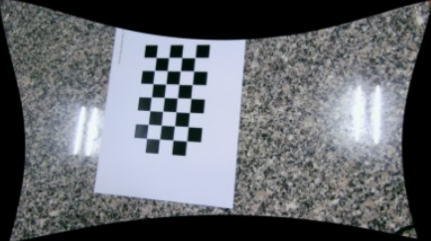

The undistorted image is then calculated using the undistort from OpenCV  taking into acount the instrinsic parameters and distortion coefficients and the new camera matrix discussed previously.

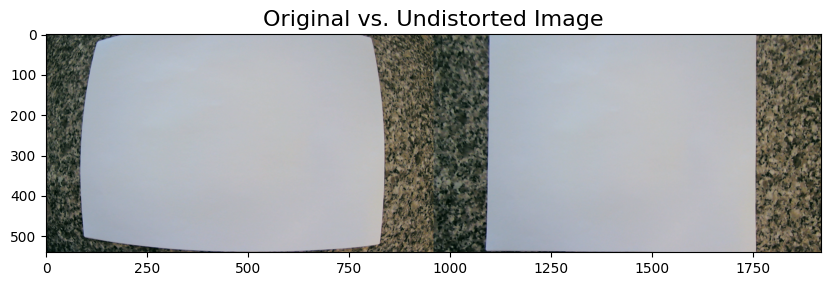

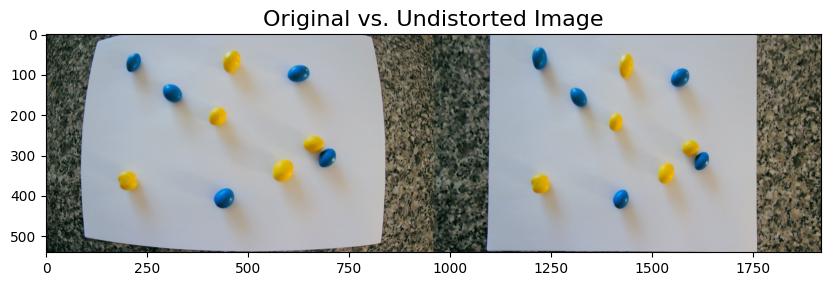

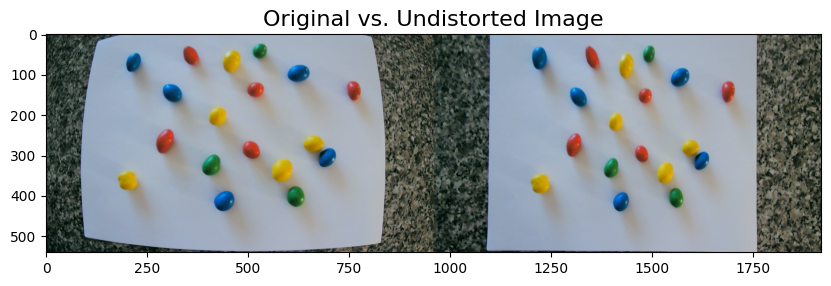

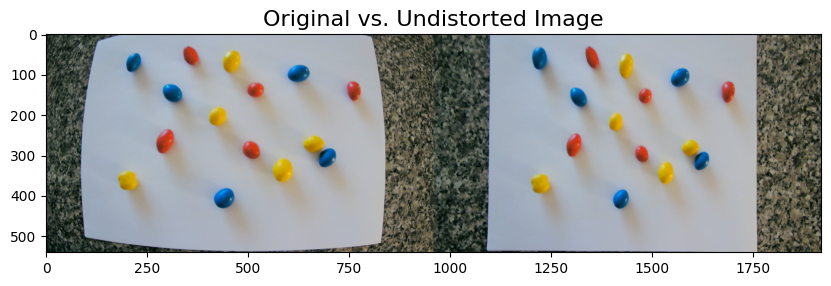

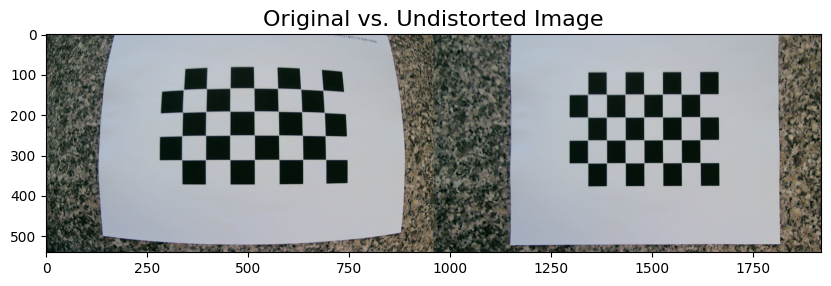

In [ ]:
# Load the distorted image
distorted_image_mm = glob.glob('/content/gdrive/MyDrive/VC_Assign_1/WhiteBackground/*.png')

# Define a single title for all the images
composite_title = "Original vs. Undistorted Image"

undistorted_image_total = []
image_roi_total = []

for fname in distorted_image_mm:
  img = cv.imread(fname)

  height, width, channels = img.shape

  newcameramatrix, roi = cv.getOptimalNewCameraMatrix(mtx, dist,
   (width, height), 1, (width, height))

  # Undistort the image
  undistorted_image = cv.undistort(img, mtx, dist, None, newcameramatrix)

  x, y, w, h = roi
  image_roi = undistorted_image[y:y+h, x:x+w]

  undistorted_image_total.append(undistorted_image)
  image_roi_total.append(image_roi)

  image_roi_resize = cv.resize(image_roi, (960,540))
  original_resize = cv.resize(img, (960,540))

  # Create a composite image by placing the original and undistorted images side by side
  composite_image = np.hstack((original_resize, image_roi_resize))

  plt.figure(figsize=(10,10))
  plt.imshow(cv.cvtColor(composite_image, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
  plt.title(composite_title, fontsize=16)
  plt.axis('On')  # Turn off axis labels
  plt.show()


The results show the images have been successfully undistorted.

Having all images distortions been corrected, we can know focus on defining our ROI for M&M detection. We aim to exclude everything in the picture that is not on the white paper sheet. This is accomplished through a series of image processing operations.


1.   **Background Segmentation:** The first major step involves segmenting the white background from the rest of the image. This is achieved by converting the image to grayscale.
A binary thresholding operation is applied to the grayscale image to create a binary mask that isolates the white background. The threshold value 150 was adjusted for better results.


2.   **Contour Detection:** Contours are identified in the binary mask using OpenCV's contour detection functions.
Contours represent the boundaries of connected regions in the binary mask. In this case, they correspond to the white background areas.

3. **Contour Filtering**: Contours with areas below a specified threshold (min_contour_area is set to 5000) are filtered out. This threshold can be adjusted to control which white background areas are retained.


4. **Mask Creation**: An empty mask is created with the same dimensions as the original image. This mask will be used to isolate the white background.

5. **Mask Application**: The filtered white background contours are drawn on the mask with a white color.
The result is a mask that highlights the white background areas in the original image.

6. **ROI Extraction**: A Region of Interest (ROI) is extracted by performing a bitwise AND operation between the original image and the background mask. This step effectively isolates the white background from the image.

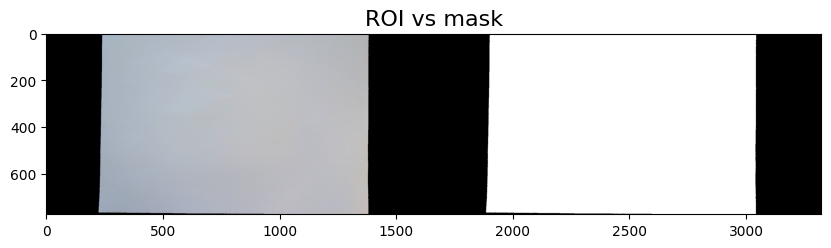

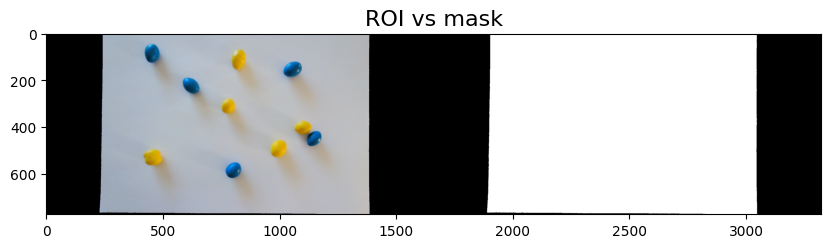

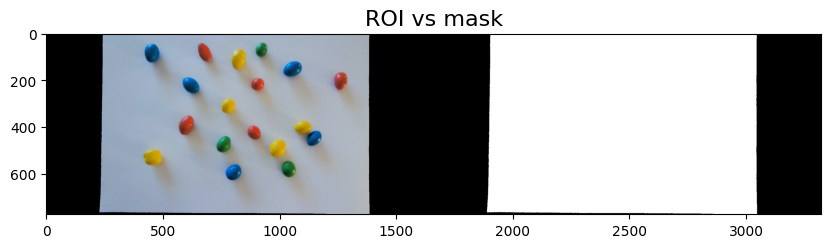

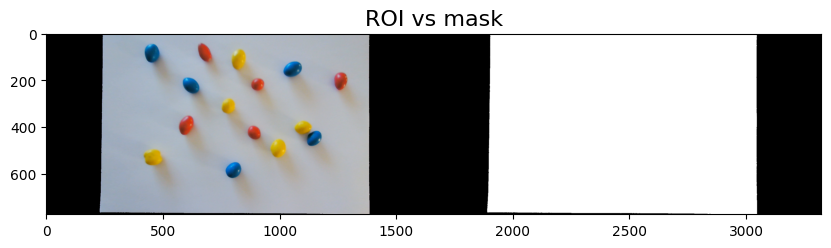

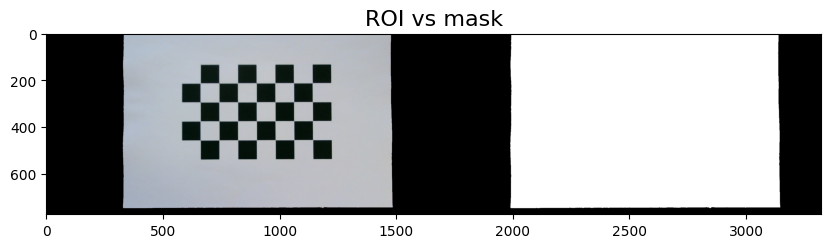

In [ ]:
# Load white background images and detect corners
images = image_roi_total

white_background_roi_total = []

for img in images:
  # img = cv.imread(fname)
  gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

  # Apply binary thresholding to segment the white background
  ret, binary = cv.threshold(gray, 150, 255, cv.THRESH_BINARY) # THIS VALUES CAN BE ADJUSTED FOR BETTER RESULTS

  # Find contours in the binary image
  contours, _ = cv.findContours(binary, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

  # Filter white background contours based on area (you may need to adjust this threshold)
  min_contour_area = 5000
  white_background_contours = [contour for contour in contours if cv.contourArea(contour) > min_contour_area]

  # Create an empty mask for the white background
  background_mask = np.zeros_like(img)

  # Draw the white background contours on the mask
  cv.drawContours(background_mask, white_background_contours, -1, (255, 255, 255), thickness=cv.FILLED)

  # Extract the ROI by bitwise ANDing the mask and the original image
  white_background_roi = cv.bitwise_and(img, background_mask)

  white_background_roi_total.append(white_background_roi)

  # Resizing just for printing

  white_prt = white_background_roi
  back_prt = background_mask

  # Create a composite image by placing the original and undistorted images side by side
  composite_image = np.hstack((white_prt, back_prt))

  composite_title = 'ROI vs mask'

  plt.figure(figsize=(10,10))
  plt.imshow(cv.cvtColor(composite_image, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
  plt.title(composite_title, fontsize=16)
  plt.axis('On')  # Turn off axis labels
  plt.show()

The results above show the ROI was effectivelly extracted from the images.



---



II. Calculate the number of M&M per color for all images provided;




---



We start by defining a function to count the M&M by color. count_objects_by_color is designed to analyze an input image and count objects of a specified color within the image. The function takes into account the color range and minimum radius of objects to consider, using OpenCV for image processing. The steps taken to achieve this are as follows:


1. **Color Space Conversion:** We start by converting the input image from the BGR color space to the HSV (Hue-Saturation-Value) color space. This conversion allows for more effective color-based analysis.

2. **Color Range Mask:** A mask is created to isolate the pixels within the specified color range. The color range is defined by a tuple of low and high HSV values, corresponding to the desired color. The mask will identify areas in the image where the color falls within this range.

3. **Contour Detection:** Contours are identified within the mask using the OpenCV findContours function. Contours represent the boundaries of connected regions within the mask, allowing us to locate areas with the specified color.

4. **Circle Detection and Filtering:** The detected contours are then filtered to identify circular objects. For each contour, the minimum enclosing circle is calculated. If the radius of the circle exceeds a specified minimum threshold (default is 10 pixels but can be adjusted), it is considered a valid object, and its center and radius are added to a list.

5. **Object Counting:** We count and return the number of objects of the specified color that meet the minimum radius criteria. Additionally, we provide information about the detected objects, such as their centers and radii.

In [ ]:
def count_objects_by_color(image, color, color_name, min_radius=10):
    # Convert the image to the HSV color space (Hue, Saturation, Value)
    im = image.copy()
    hsv_image = cv.cvtColor(im, cv.COLOR_BGR2HSV)

    # Create a mask for the specified color range
    color_mask = 0
    for low, high in color:
      color_mask += cv.inRange(hsv_image, low, high)

    # Find contours in the mask
    contours, _ = cv.findContours(color_mask, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

    # Filter for circles with given threshold of radius
    circles = []
    for cnt in contours:
      (x, y), radius = cv.minEnclosingCircle(cnt)
      center = (int(x), int(y))
      radius = int(radius)
      if radius < min_radius:
        continue
      circles.append([center, radius])

    # Count candies of the specified color
    return len(circles), circles

The HSV limits for each color are defined below.

In [ ]:
# For red
red = [
    [np.array([0, 170, 60]), np.array([10, 255, 255])],
    [np.array([170, 170, 60]), np.array([180, 255, 255])],
]

# For blue
blue = [
    [np.array([100, 170, 60]), np.array([130, 255, 255])],
]

# For yellow
yellow = [
    [np.array([20, 170, 60]), np.array([35, 255, 255])],
]

# For green
green = [
    [np.array([45, 170, 60]), np.array([70, 255, 255])],
]

In this chunk we apply the count_objects_by_color. A Python dictionary named color_counts is used to track and record the counts of objects of specific colors in a collection of images.

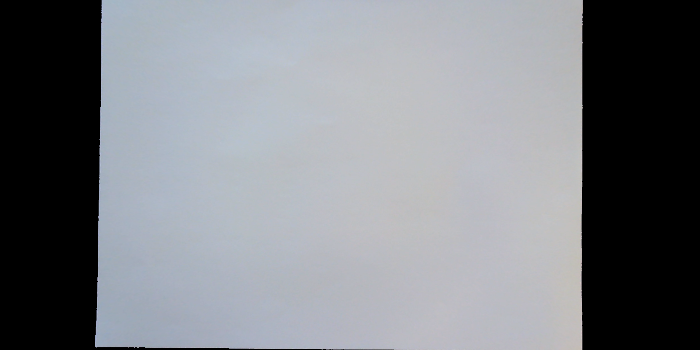

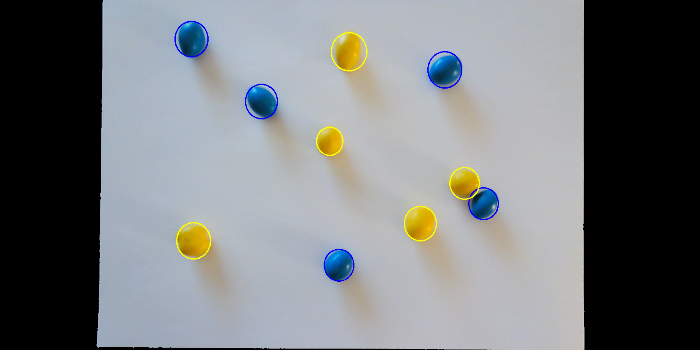

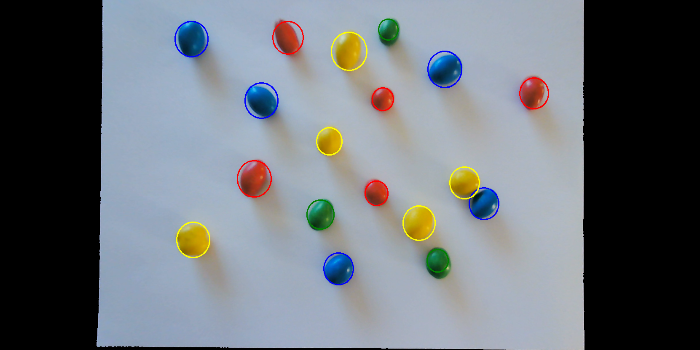

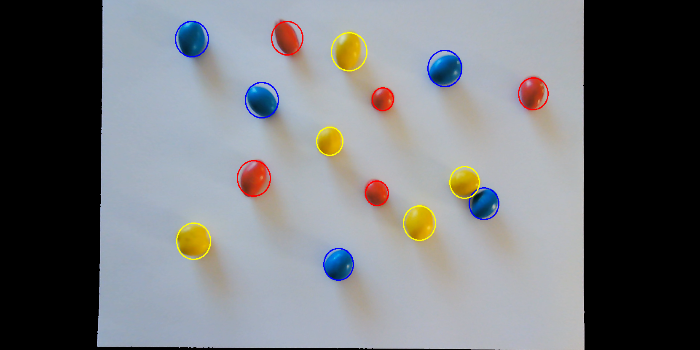

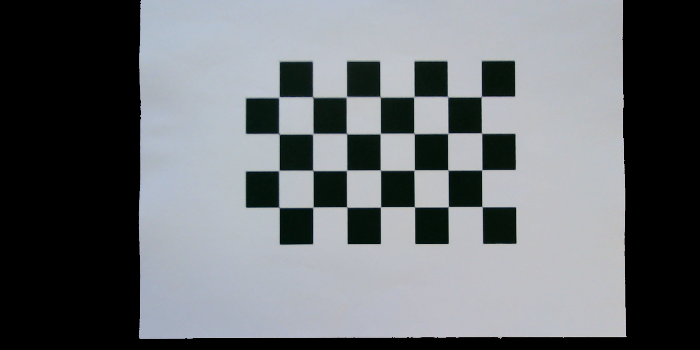

In [ ]:
color_counts = {}

for i, image in enumerate(white_background_roi_total):
  color_counts[f'F{i}_Red'.format(i)], r_circles = count_objects_by_color(image, red, "Red")
  color_counts[f'F{i}_Blue'.format(i)], b_circles = count_objects_by_color(image, blue, "Blue")
  color_counts[f'F{i}_Yellow'.format(i)], y_circles = count_objects_by_color(image, yellow, "Yellow")
  color_counts[f'F{i}_Green'.format(i)], g_circles = count_objects_by_color(image, green, "Green")

  im = image.copy()
  for center, radius in r_circles:
    cv.circle(im, center, radius, webcolors.name_to_rgb("Red")[::-1] , 2)
  for center, radius in b_circles:
    cv.circle(im, center, radius, webcolors.name_to_rgb("Blue")[::-1] , 2)
  for center, radius in y_circles:
    cv.circle(im, center, radius, webcolors.name_to_rgb("Yellow")[::-1] , 2)
  for center, radius in g_circles:
    cv.circle(im, center, radius, webcolors.name_to_rgb("Green")[::-1] , 2)

  img_prt = cv.resize(im, (700,350))
  cv2_imshow(img_prt)

By visual inspection we can confirm in the images above that all M&M have been detected also by its correct color. We can also see below the actual count per image which are compliant with what we see in each image.

In [ ]:
for color, count in color_counts.items():
    print(f"Color: {color}, Total Count: {count}")

Color: F0_Red, Total Count: 0
Color: F0_Blue, Total Count: 0
Color: F0_Yellow, Total Count: 0
Color: F0_Green, Total Count: 0
Color: F1_Red, Total Count: 0
Color: F1_Blue, Total Count: 5
Color: F1_Yellow, Total Count: 5
Color: F1_Green, Total Count: 0
Color: F2_Red, Total Count: 5
Color: F2_Blue, Total Count: 5
Color: F2_Yellow, Total Count: 5
Color: F2_Green, Total Count: 3
Color: F3_Red, Total Count: 5
Color: F3_Blue, Total Count: 5
Color: F3_Yellow, Total Count: 5
Color: F3_Green, Total Count: 0
Color: F4_Red, Total Count: 0
Color: F4_Blue, Total Count: 0
Color: F4_Yellow, Total Count: 0
Color: F4_Green, Total Count: 0




---



III. Determine the average area for peanuts in pixels, considering the
image “calib_img 3”



---



In order to be able to calculate the average area of the M&M, the following pre-processing is performed:

1. **Color Range Masking:** The image is first converted from the BGR color space to the HSV color space. Subsequently, a color range mask is created in the HSV space. The mask isolates specific color ranges within the image. In this code, the color range is set to a specific hue range with a sensitivity threshold.

2. **Color Inversion and Filtering:** The color mask is applied to the HSV image to filter out pixels that do not match the specified color range. The filtered image, referred to as hsv_im, effectively highlights the target color while suppressing other colors.


3. **Grayscale Conversion and Filtering:**  The saturation channel (S) is extracted from the filtered HSV image and applies a bilateral filter to reduce noise while preserving edges. The result is a grayscale image, gray, which will be used for further processing.

4. **Binary Thresholding and Morphological Operations:** A binary threshold is applied to the grayscale image to separate objects of interest from the background. The code uses an elliptical kernel for morphological operations, including erosion and dilation, to enhance and refine the segmented objects.

4. **Edge Detection and Contour Identification:** The Canny edge detection algorithm is applied to the preprocessed image to detect edges within the objects of interest.
Contours are identified in the binary edge image using OpenCV's findContours function.


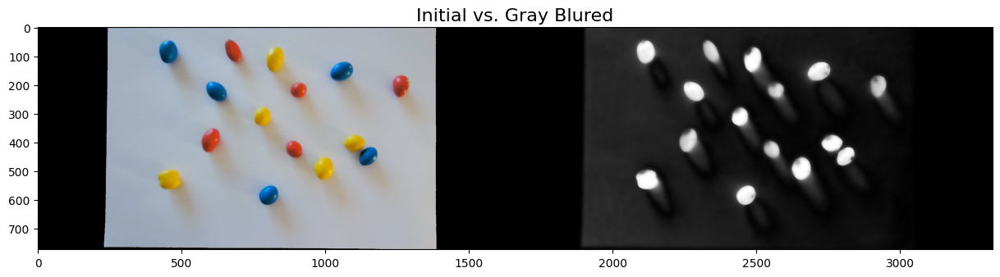

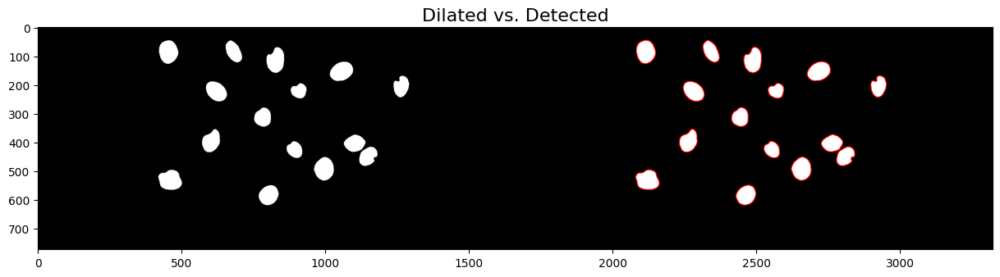

In [ ]:
img = white_background_roi_total[3].copy()


#Convert the image to grayscale
hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)

sensitivity = 15
low = (0, 0, 255-sensitivity)
high = (255, sensitivity, 255)

# Convert to binary
mask = cv.inRange(hsv, low, high)
max_value = 255


hsv_im = cv.bitwise_not(hsv, hsv, mask=mask)


# Apply filter
gray = cv.split(hsv_im)[1]
gray = cv.bilateralFilter(gray, d=20, sigmaColor=100, sigmaSpace=100)


# Elipse kernel
lower = (127)
upper = (255)
thresh = cv.inRange(gray, lower, upper)
kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(3,3))

eroded = cv.erode(thresh, kernel, iterations=2)
dilated = cv.dilate(eroded, kernel, iterations=3)


# Create a copy of the original image for visualization
image_with_contours = dilated.copy()
image_with_contours_rgb = cv.cvtColor(image_with_contours, cv.COLOR_GRAY2BGR)


# Apply Canny edge detection
edges = cv.Canny(image_with_contours, 100, 255)

# Find contours in the binary edge image
contours, _ = cv.findContours(edges, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

# Draw all the detected contours on the copy of the original image
cv.drawContours(image_with_contours_rgb, contours, -1, (0, 0, 255), 2)

composite_image_3 = np.hstack((img, cv.cvtColor(gray, cv.COLOR_GRAY2BGR)))
composite_title_3 = 'Initial vs. Gray Blured'

plt.figure(figsize=(15,20))
plt.imshow(cv.cvtColor(composite_image_3, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
plt.title(composite_title_3, fontsize=16)
plt.axis('On')  # Turn off axis labels
plt.show()

composite_image_3 = np.hstack((cv.cvtColor(image_with_contours, cv.COLOR_GRAY2BGR), image_with_contours_rgb))
composite_title_3 = 'Dilated vs. Detected'

plt.figure(figsize=(15,20))
plt.imshow(cv.cvtColor(composite_image_3, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
plt.title(composite_title_3, fontsize=16)
plt.axis('On')  # Turn off axis labels
plt.show()

After all contours have been detected we can easily calculate the areas totals, mean and standard deviatiation by using contourArea from OpenCV.

In [ ]:
mm_areas_px = []
for c in contours:
  mm_areas_px.append(cv.contourArea(c))


print(mm_areas_px)
print('Total area:', np.sum(mm_areas_px), 'px2', 'Mean:', np.mean(mm_areas_px), 'px2', ', Std:', np.std(mm_areas_px))

[3661.5, 4407.0, 4268.5, 3069.5, 2362.0, 3286.0, 3578.0, 3002.0, 2145.0, 3813.5, 2939.0, 4137.0, 4082.0, 2994.5, 4245.0]
Total area: 51990.5 px2 Mean: 3466.0333333333333 px2 , Std: 683.4399380259314




---



i. Show all peanuts that were detected.



---



The image plotted in the chunk above shows all 18 peanuts contours from the original image were detected.

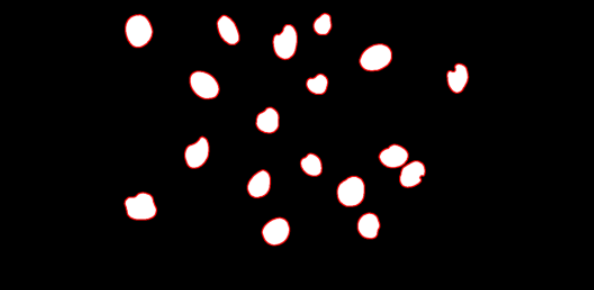



---



ii. Discuss the limitations of the peanut detection method used
(in 2 sentences).



---



*   The method struggles with complex and intertwined light reflections in the M&M, leading to slight inacuracies in the contour detection process: this is the major limitation in regards to area measurement reliability
*  It relies on predefined thresholds, which have to be reacessed in a case-by-case basis to test if they are generalizable for different pictures that slightly vary the lighting conditions





---



IV. Determine the average area (and standard deviation) for peanuts
in millimeters and grouped by color, considering images “calib_img
2” and “calib_img 3”.



---



For better area detection by color, the HSV limits were adjusted as follows.

In [ ]:
# For red
red = [
    [np.array([0, 100, 20]), np.array([10, 255, 255])],
    [np.array([160, 100, 00]), np.array([179, 255, 255])],
]

# For blue
blue = [
    [np.array([90, 120, 20]), np.array([125, 255, 255])],
]

# For yellow
yellow = [
    [np.array([20, 100, 15]), np.array([45, 255, 255])],
]

# For green
green = [
    [np.array([35, 100, 20]), np.array([92, 255, 255])],
]

Looking for red peanuts in image 0


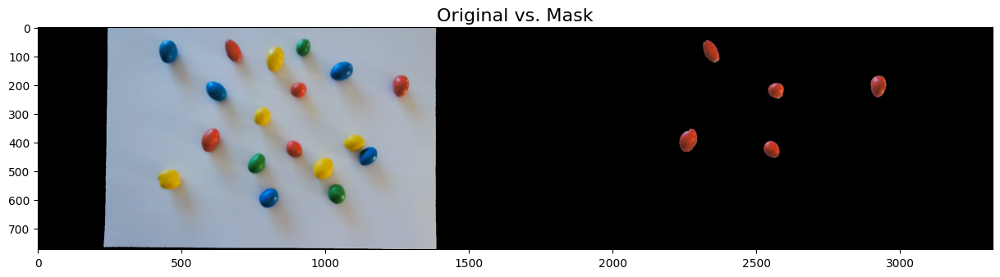

I found some peanutssss! 
 Areas in px: [2387.5, 3630.5, 2253.0, 3112.5, 2998.0] 
 Areas in mm: [163.47557616285076, 248.585582935803, 154.26616674132052, 213.1173741599468, 205.27739364868128] 
 Total area: 984.7220936486024 mm2 
 Mean: 196.94441872972047 mm2 
 Standard deviation: 34.465662374192
Looking for blue peanuts in image 0


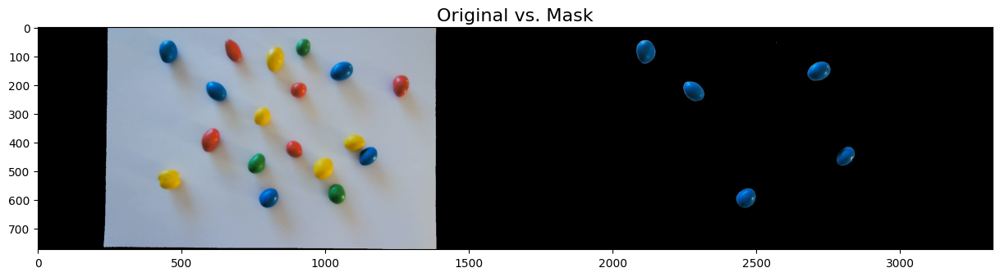

I found some peanutssss! 
 Areas in px: [3433.0, 2952.0, 3642.0, 3949.5, 4110.5] 
 Areas in mm: [235.0624724469389, 202.12770715507244, 249.3730045592052, 270.42797405452524, 281.45187678215626] 
 Total area: 1238.443034997898 mm2 
 Mean: 247.68860699957958 mm2 
 Standard deviation: 27.91089129351506
Looking for yellow peanuts in image 0


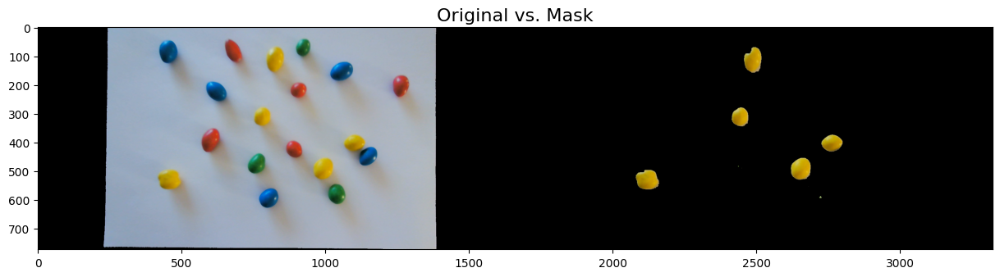

I found some peanutssss! 
 Areas in px: [4231.0, 4144.5, 3140.0, 2913.5, 3962.0] 
 Areas in mm: [289.7026859665012, 283.7799059296063, 215.0003389115608, 199.49155650281284, 271.2838671234407] 
 Total area: 1259.2583544339218 mm2 
 Mean: 251.85167088678435 mm2 
 Standard deviation: 37.22720519390428
Looking for green peanuts in image 0


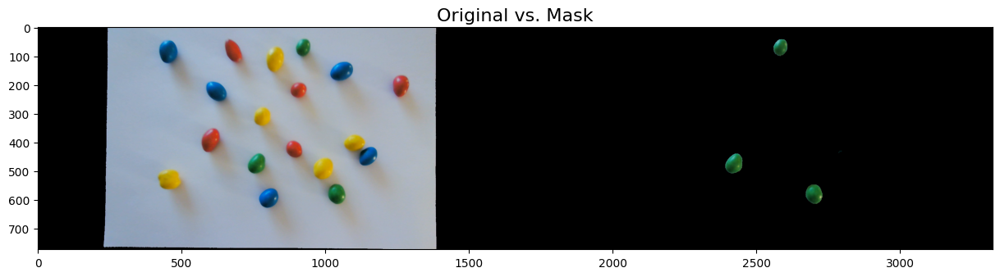

I found some peanutssss! 
 Areas in px: [2996.0, 3078.5, 2124.0] 
 Areas in mm: [205.1404507576548, 210.78934501249677, 145.4333502701131] 
 Total area: 561.3631460402647 mm2 
 Mean: 187.12104868008825 mm2 
 Standard deviation: 29.56772621870428


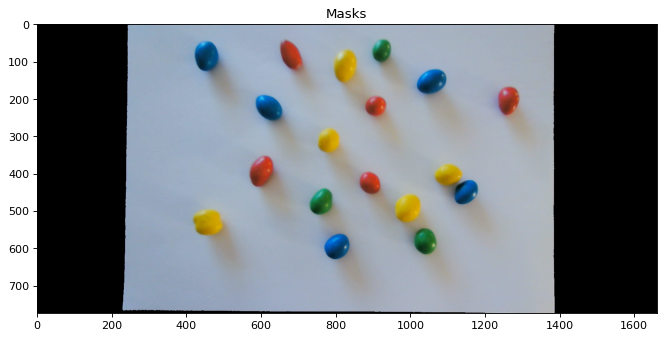

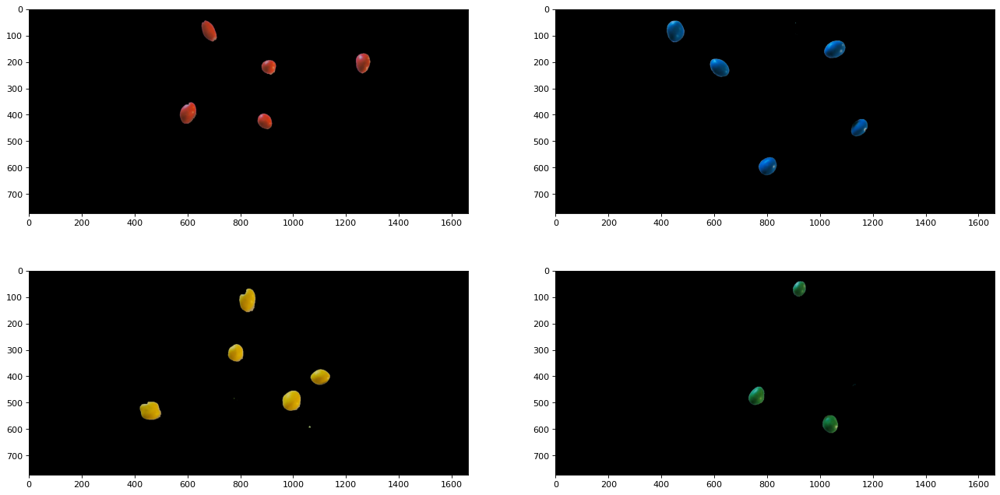

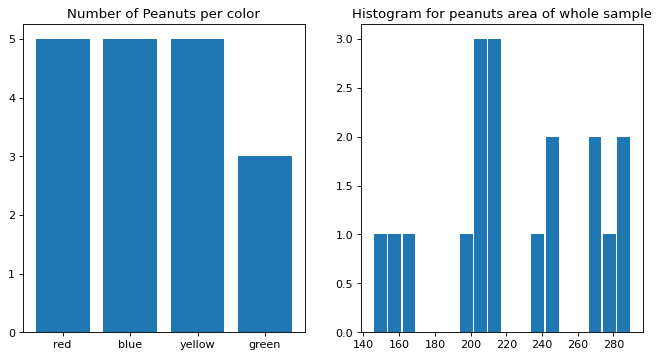

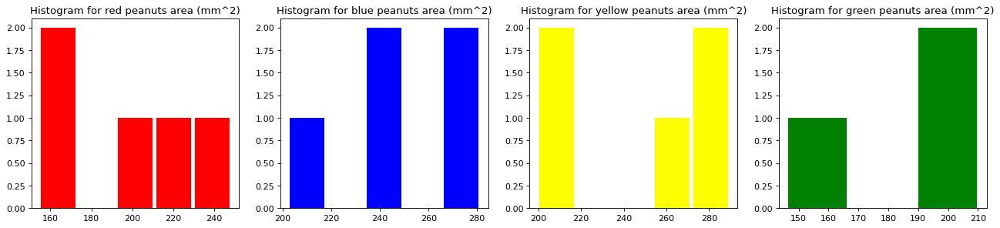

Looking for red peanuts in image 1


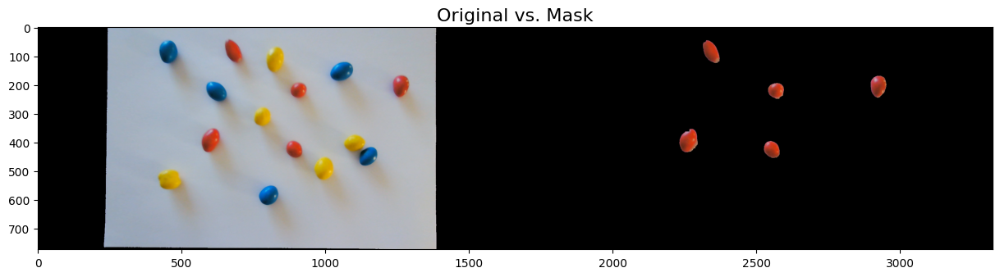

I found some peanutssss! 
 Areas in px: [2423.0, 3780.5, 2268.0, 3141.5, 3051.0] 
 Areas in mm: [165.90631247857064, 258.8562997627884, 155.29323842401905, 215.10304607983065, 208.9063802608828] 
 Total area: 1004.0652770060915 mm2 
 Mean: 200.8130554012183 mm2 
 Standard deviation: 37.227028879569104
Looking for blue peanuts in image 1


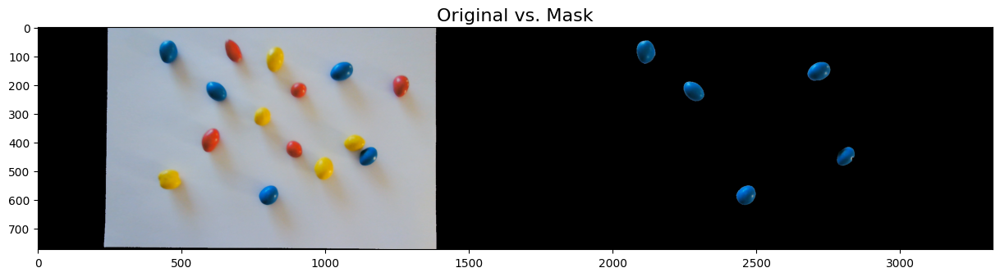

I found some peanutssss! 
 Areas in px: [3398.5, 2873.0, 3552.0, 3864.0, 3978.5] 
 Areas in mm: [232.70020757673225, 196.7184629595268, 243.21057446301398, 264.5736654631436, 272.4136459744091] 
 Total area: 1209.6165564368257 mm2 
 Mean: 241.92331128736515 mm2 
 Standard deviation: 26.73162940974419
Looking for yellow peanuts in image 1


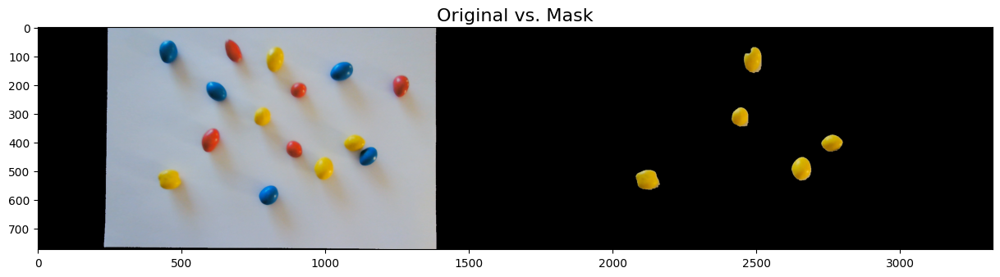

I found some peanutssss! 
 Areas in px: [4365.0, 4197.5, 3169.0, 3027.0, 4126.5] 
 Areas in mm: [298.8778596652748, 287.40889254180775, 216.98601083144462, 207.2630655685651, 282.54741991036803] 
 Total area: 1293.0832485174606 mm2 
 Mean: 258.6166497034921 mm2 
 Standard deviation: 38.45241405774011
Looking for green peanuts in image 1


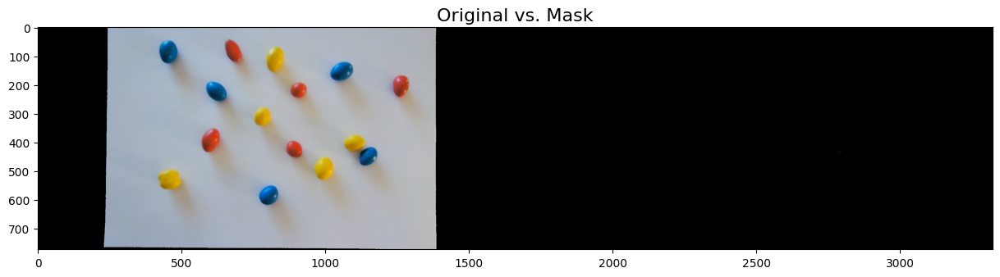

green is missing!


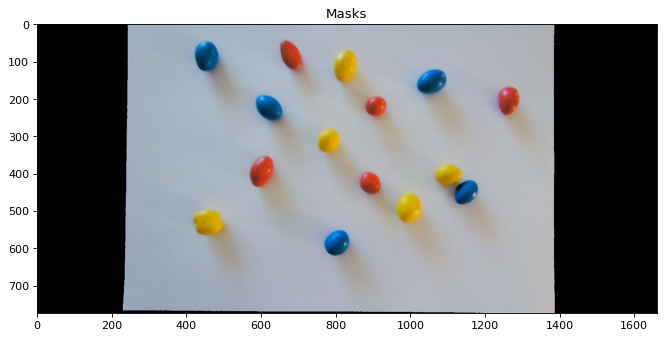

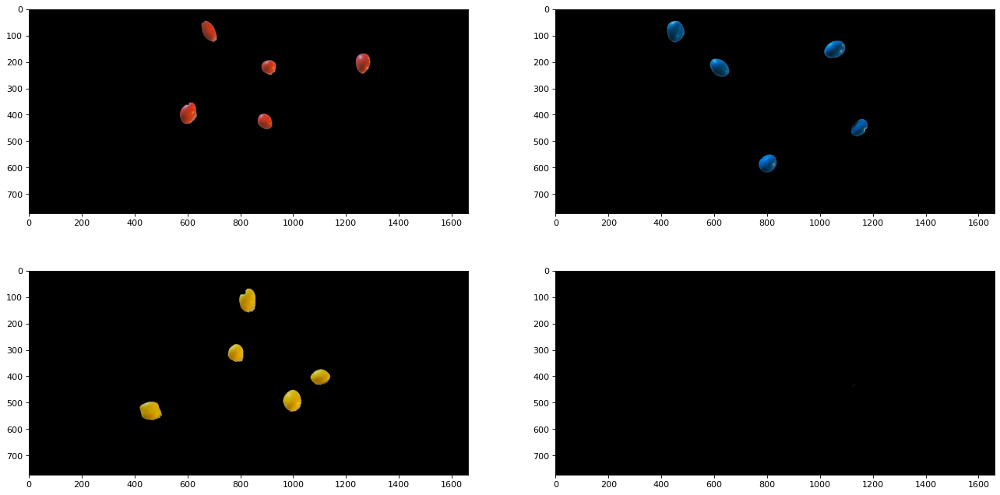

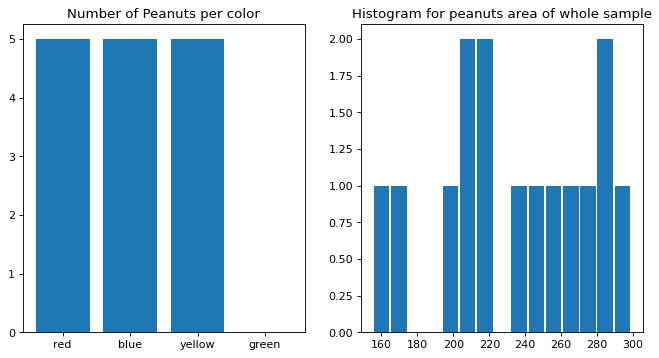

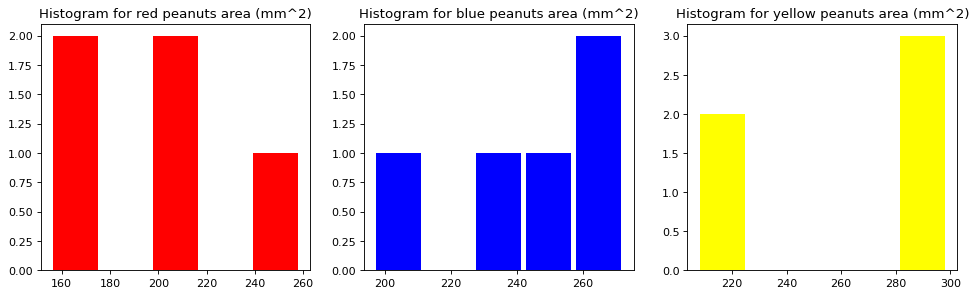

In [ ]:
calib_img_2 = white_background_roi_total[2].copy()
calib_img_3 = white_background_roi_total[3].copy()

ratio_mm_px = 1 / px_mm_ratio

scope = [calib_img_2, calib_img_3]

colors = {'red': red,
          'blue': blue,
          'yellow': yellow,
          'green': green}

areas = []
area_in_px = []
area_in_mm = []

table_color_area = []

for j, i in enumerate(scope):
  img_rgb = cv.cvtColor(i, cv.COLOR_BGR2RGB)
  sum_area = np.array([0,0,0,0])
  sum_peanuts = np.array([0,0,0,0])

  masks_img = []
  masks_img.append(i)

  areas = []

  for idx, (key, color) in enumerate(colors.items()):
    area_in_px = []
    area_in_mm = []

    print(f"Looking for {key} peanuts in image {j}")
    frame_HSV = cv.cvtColor(img_rgb, cv.COLOR_RGB2HSV)

    # Create a mask for the specified color range
    mask = 0
    for low, high in color:
      mask += cv.inRange(frame_HSV, low, high)

    kernel = np.ones((11,11), 'uint8')
    mask = cv.dilate(mask, kernel, iterations=2)
    mask= cv.erode(mask, kernel, iterations=2)

    result = cv.bitwise_and(frame_HSV, frame_HSV, mask=mask)
    result = cv.cvtColor(result, cv.COLOR_HSV2BGR)

    # cv2_imshow(result)

    masks_img.append(result)

    composite_image = np.hstack((i, result))
    composite_title = 'Original vs. Mask'

    plt.figure(figsize=(15,20))
    plt.imshow(cv.cvtColor(composite_image, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
    plt.title(composite_title, fontsize=16)
    plt.axis('On')  # Turn off axis labels
    plt.show()

    contours, _ = cv.findContours(mask, cv.RETR_TREE, cv.CHAIN_APPROX_NONE)

    #Countours above 1000

    for c in contours:
      if (cv.contourArea(c)<1000):
        continue
      sum_area[idx] = sum_area[idx] + cv.contourArea(c)
      sum_peanuts[idx] += 1
      areas.append(cv.contourArea(c))
      area_in_px.append(cv.contourArea(c))
      area_in_mm.append(cv.contourArea(c)* ratio_mm_px **2)

    if sum_peanuts[idx] == 0:
      print(f"{key} is missing!")
    else:
      print(f"I found some peanutssss! \n Areas in px: {area_in_px} \n Areas in mm: {area_in_mm} \n Total area: {np.sum(area_in_mm)} mm2 \n Mean: {np.mean(area_in_mm)} mm2 \n Standard deviation: {np.std(area_in_mm)}")

    sum_area_mm = (ratio_mm_px **2) * sum_area

  for k in range(len(masks_img)):
    masks_img[k] = cv.cvtColor(masks_img[k],cv.COLOR_BGR2RGB)

  plt.figure(figsize=(10, 8), dpi=80)
  plt.title("Masks")
  plt.imshow(masks_img[0])
  plt.show()

  plt.figure(figsize=(20, 10), dpi=80)
  plt.subplot(2,2,1)
  plt.imshow(masks_img[1])
  plt.subplot(2,2,2)
  plt.imshow(masks_img[2])
  plt.subplot(2,2,3)
  plt.imshow(masks_img[3])
  plt.subplot(2,2,4)
  plt.imshow(masks_img[4])
  plt.show()

  plt.figure(figsize=(10, 5), dpi=80)
  plt.subplot(1,2,1)
  plt.title('Number of Peanuts per color')
  plt.bar(colors.keys(),sum_peanuts)
  plt.subplot(1,2,2)
  plt.title('Histogram for peanuts area of whole sample')
  areas_mm = np.array(areas) * (ratio_mm_px**2)
  plt.hist(areas_mm,bins=len(areas),rwidth=0.9)
  plt.show()

  plt.figure(figsize=(20, 4), dpi=80)
  sum_idx = 0
  for i, c in enumerate(colors.keys()):
    if sum_peanuts[i] > 0:
      plt.subplot(1,4,i+1)
      v = areas_mm[sum_idx:sum_idx+sum_peanuts[i]]
      sum_idx += sum_peanuts[i]
      plt.title('Histogram for ' + c + ' peanuts area (mm^2)')
      plt.hist(v, bins=sum_peanuts[i], rwidth=0.9, color=c)
      for a in v:
        table_color_area.append([c, j, a])
  plt.show()

i. Show the result in a table color vs area and standard
deviation.




---



The total area and standard deviation per color in both images can be found below.

In [ ]:
df_color_area = pd.DataFrame(table_color_area, columns=['color', 'img_idx', 'area_mm2'])
df_color_area.groupby('color').agg({'area_mm2' : ['mean','std', 'count']})

area_mm2                 
              mean        std count
color                              
blue    244.805959  28.965661    10
green   187.121049  36.212921     3
red     198.878737  37.868315    10
yellow  255.234160  40.050908    10

The total area and standard deviation per image can be found below.

In [ ]:
df_color_area.groupby(['img_idx', 'color']).agg({'area_mm2' : ['mean','std', 'count']})

area_mm2                 
                      mean        std count
img_idx color                              
0       blue    247.688607  31.205325     5
        green   187.121049  36.212921     3
        red     196.944419  38.533782     5
        yellow  251.851671  41.621281     5
1       blue    241.923311  29.886870     5
        red     200.813055  41.621084     5
        yellow  258.616650  42.991106     5



---



ii. Discuss the limitation of the method implemented (in 2
sentences).



---



* The method struggles with complex and intertwined light reflections in the M&M, leading to slight inacuracies in the contour detection process: this is the major limitation in regards to area measurement reliability

* Detecting by colour is challenging in terms of threshold definition  since it can be heavily affected by lighting and many iterations were required to find the acceptable ones: One could perform a deeper study to corner the worst case scenarios (in terms of ilumination) to make these limits more generalizable.



---



V. Provide some recommendations that the M&M factory should take
into consideration to improve the performance of the quality
assurance process based on image processing (e.g., imaging
setup, calibration process and photometric effects), in 4 sentences.



---



* Standardize surrounding lighting, minimizing shadows and reflective points on the objects of interest
* Stardardize a neutral background for the photo that enables a good object detection without interference
* Standardize object  of interest location for inspection in order to prevent very close M&M: this can be achieved like creating a special cast where M&M would fit and be spaced at a proper distance from each other.
* Implement Statistical Process Control (SPC) for important process and product parameters (like diameter) that continously monitors them and flags an alert in case of violation of process control limits

##### d) Consider the images retrieved from a Grey Background and repeat the previous point without defining a region of interest.



---



This exercise involved detecting the MMs without using the ROI, which made it much more difficult because there was a very noisy image background with patterns that could confuse certain colors (namely brown).
The procedure was the same as for the previous exercise, also undistorting the images to be used. There are a few techniques that have been explored, but not all of them have had good results, starting with:

**Closing** - An important operator from the field of mathematical morphology. Like its dual operator opening, it can be derived from the fundamental operations of erosion and dilation. Like those operators it is normally applied to binary images, although there are graylevel versions. Closing is similar in some ways to dilation in that it tends to enlarge the boundaries of foreground (bright) regions in an image (and shrink background color holes in such regions), but it is less destructive of the original boundary shape.

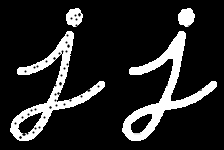


**Gaussian blur** -  A feature obtained by blurring (smoothing) an image using a Gaussian function to reduce the noise level. It can be considered as a nonuniform low-pass filter that preserves low spatial frequency and reduces image noise and negligible details in an image. It is typically achieved by convolving an image with a Gaussian kernel.

**Watershed** - A segmentation technique that partitions an image into distinct regions based on gradients and intensity variations.

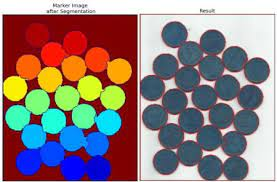

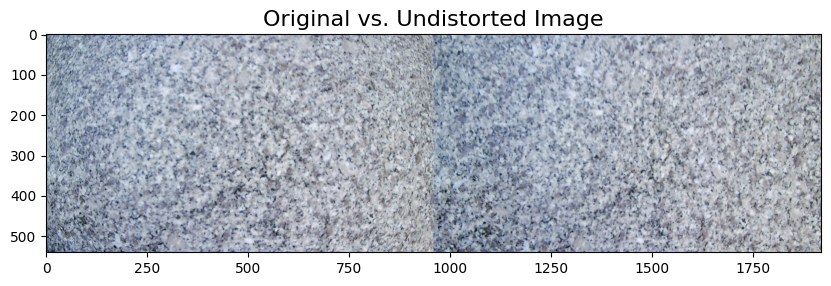

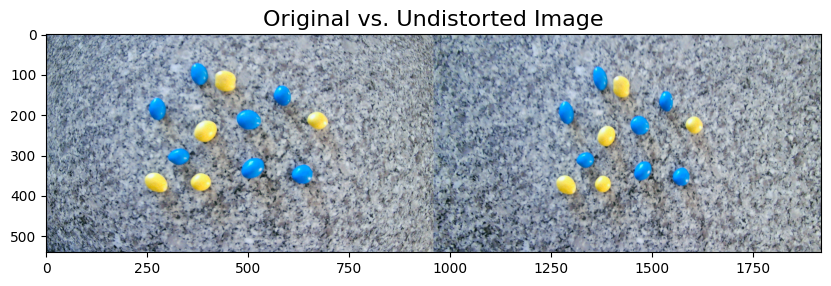

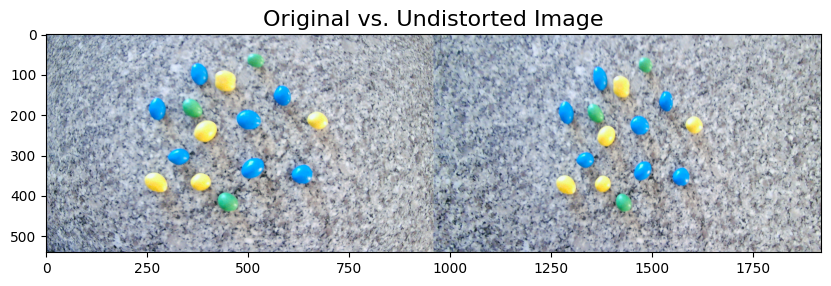

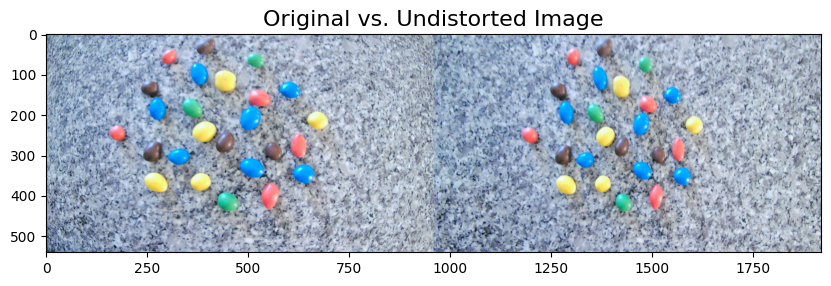

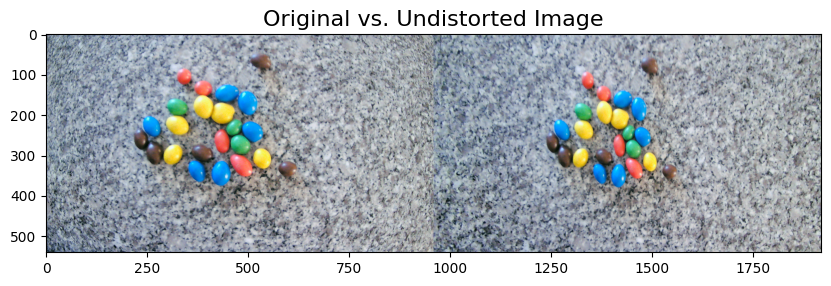

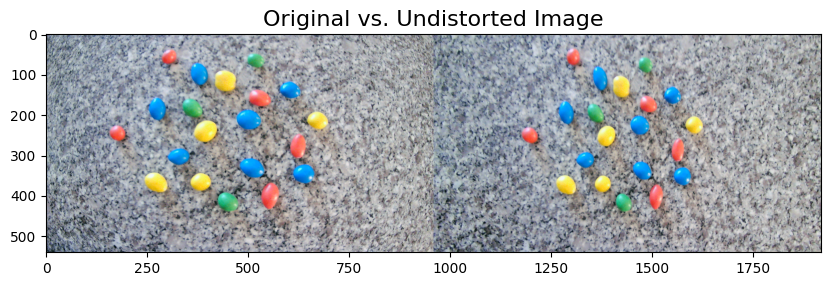

In [ ]:
#Load the distorted image
distorted_image_mm = glob.glob('/content/gdrive/MyDrive/VC_Assign_1/GreyBackground/calib_img*.png')

# Define a single title for all the images
composite_title = "Original vs. Undistorted Image"

undistorted_image_total_g = []
image_roi_total_g = []

for fname in distorted_image_mm:
  img = cv.imread(fname)

  height, width, channels = img.shape

  newcameramatrix, roi = cv.getOptimalNewCameraMatrix(mtx, dist,
   (width, height), 1, (width, height))

  # Undistort the image
  undistorted_image = cv.undistort(img, mtx, dist, None, newcameramatrix)

  x, y, w, h = roi
  image_roi = undistorted_image[y:y+h, x:x+w]

  undistorted_image_total_g.append(undistorted_image)
  image_roi_total_g.append(image_roi)

  image_roi_resize_ = cv.resize(image_roi, (960,540))
  original_resize_ = cv.resize(img, (960,540))

  # Create a composite image by placing the original and undistorted images side by side
  composite_image = np.hstack((original_resize_, image_roi_resize_))

  plt.figure(figsize=(10,10))
  plt.imshow(cv.cvtColor(composite_image, cv.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
  plt.title(composite_title, fontsize=16)
  plt.axis('On')  # Turn off axis labels
  plt.show()




---



d) II Calculate the number of M&M per color for all images provided



---



1. **Image pre-processing:** The image is blurred using a Gaussian blur filter with a kernel size of 7x7. The blurred image is then converted from the BGR color space to the LAB color space. This color space conversion is performed to facilitate more effective color-based segmentation. A binary mask is created for the color range by thresholding the LAB image, morphological erosion to the binary mask for noise reduction (2 iterations) and dilation to the binary mask for better coverage and isolation of M&M candies (4 iterations).

2.  **Thresholding:** The grayscale image is thresholded using Otsu's thresholding method. This step effectively separates objects of interest from the background.

2. **Distance Transform:** The function computes the Euclidean distance transform of the thresholded image. This operation calculates the distance from each pixel to the nearest zero pixel, effectively creating a distance map.

3. **Peak Detection:** The code identifies local peaks within the distance map. These peaks represent potential centers of M&M candies.

4. **Watershed Algorithm:** To accurately segment and separate the individual M&M candies, the Watershed algorithm is applied. This algorithm is especially useful in cases where multiple objects are in close proximity.
The connected components (local peaks) are analyzed, and the Watershed algorithm helps delineate the boundaries of each M&M candy based on the regional minima in the distance map.

5. **M&M Candy Detection:**A binary mask is created to isolate the pixels corresponding to the current M&M candy. Contours are detected within this binary mask. The largest contour is selected as the primary contour for the M&M candy. A bounding box is drawn around the detected M&M candy based on the selected contour.







In [ ]:
def draw_mms(image, color):
  output = image.copy()
  gray = cv.cvtColor(output, cv.COLOR_BGR2GRAY)

  # convert the mean shift image to grayscale, then apply
  # Otsu's thresholding

  thresh = cv.threshold(gray, 0, 255, cv.THRESH_BINARY | cv.THRESH_OTSU)[1]

  # compute the exact Euclidean distance from every binary
  # pixel to the nearest zero pixel, then find peaks in this
  # distance map
  D = ndimage.distance_transform_edt(thresh)
  localMax = peak_local_max(D, indices=False, min_distance=20, labels=thresh)
  # perform a connected component analysis on the local peaks,
  # using 8-connectivity, then appy the Watershed algorithm
  markers = ndimage.label(localMax, structure=np.ones((3, 3)))[0]
  labels = watershed(-D, markers, mask=thresh)

  # loop over the unique labels returned by the Watershed
  # algorithm
  radis = []
  for label in np.unique(labels):
    # if the label is zero, we are examining the 'background'
    # so simply ignore it
    if label == 0:
      continue
    # otherwise, allocate memory for the label region and draw
    # it on the mask
    mask = np.zeros(gray.shape, dtype="uint8")
    mask[labels == label] = 255
    # detect contours in the mask and grab the largest one
    cnts = cv.findContours(mask.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv.contourArea)
    # draw a circle enclosing the object
    ((x, y), r) = cv.minEnclosingCircle(c)
    if r < 25:
      continue
    cv.circle(output, (int(x), int(y)), int(r), (0, 255, 0), 2)
    cv.putText(output, "#{}".format(label), (int(x) - 10, int(y)), cv.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2)
    radis.append(r)

  return output, radis

In [ ]:
colors_2 = {
    'Red': [((130, 155, 110), (220, 195, 170))],
    'Yellow': [((180, 100, 160), (250, 135, 220))],
    'Blue': [((130, 110, 60), (180, 150, 80))],
    'Green': [((100, 80, 110), (200, 100, 170))],
    'Brown': [((60, 133, 120), (139, 147, 144))],
}


def process(image):
  kernel = np.ones((5, 5))
  image = cv.blur(image, (7, 7))
  lab = cv.cvtColor(image, cv.COLOR_BGR2LAB)

  rets = []
  radis = []
  colors = []
  for i, (c, b) in enumerate(colors_2.items()):
    mask = 0
    for (l, h) in b:
      mask += cv.inRange(lab, np.array(l), np.array(h))
    mask = cv.erode(mask, kernel, iterations=2)
    mask = cv.dilate(mask, kernel, iterations=4)
    result = cv.bitwise_and(image, image, mask=mask)

    colors.append(c)

    result, radis_out = draw_mms(result, c)
    radis.append(radis_out)
    rets.append(result)
  return rets, radis, colors

In [ ]:
def display(img, m_img, cmap="gray", color='color'):
    img = img[:, :, ::-1]
    m_img = m_img[:, :, ::-1]

    f, axs = plt.subplots(1,2,figsize=(15,10))
    axs[0].imshow(img,cmap="gray")
    axs[1].imshow(m_img,cmap="gray")
    axs[1].set_title(f"{color} mask")

<ipython-input-25-9c2bbb28b4b4>:14: FutureWarning: indices argument is deprecated and will be removed in version 0.20. To avoid this warning, please do not use the indices argument. Please see peak_local_max documentation for more details.
  localMax = peak_local_max(D, indices=False, min_distance=20, labels=thresh)
<ipython-input-27-22252e0349ba>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f, axs = plt.subplots(1,2,figsize=(15,10))


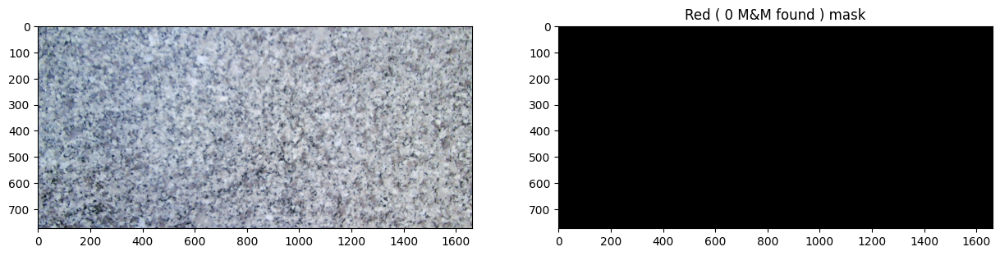

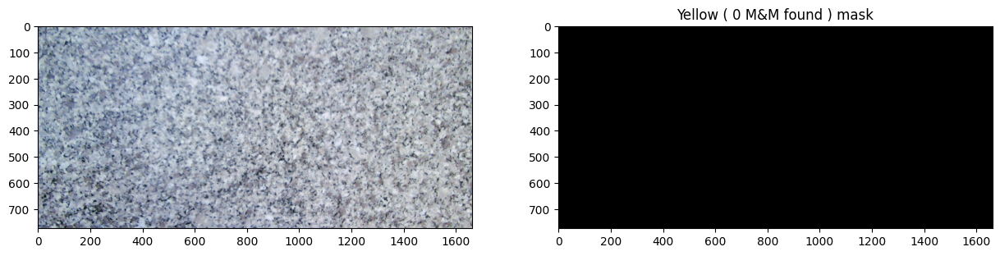

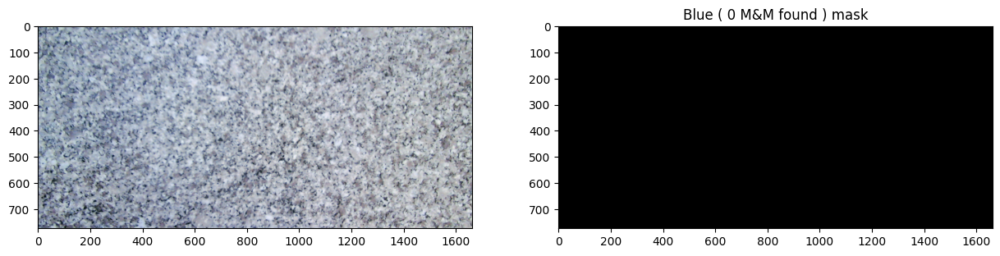

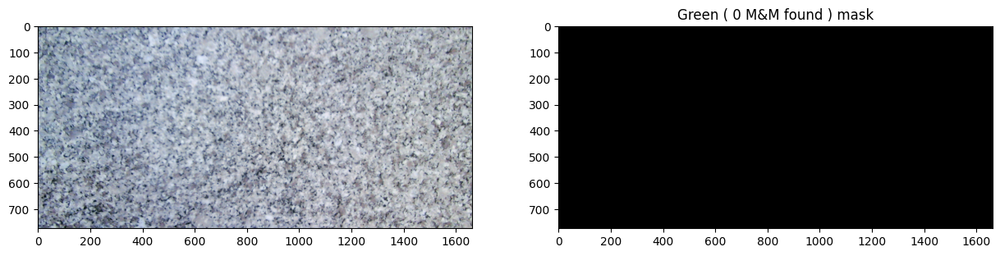

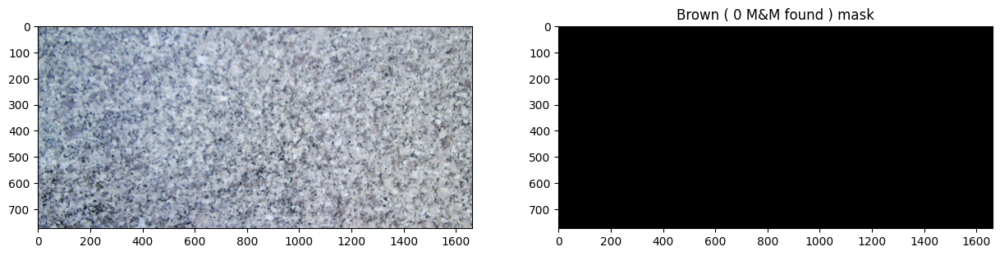

...

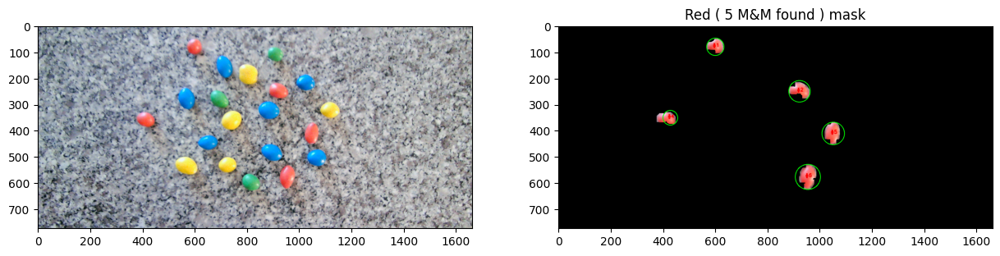

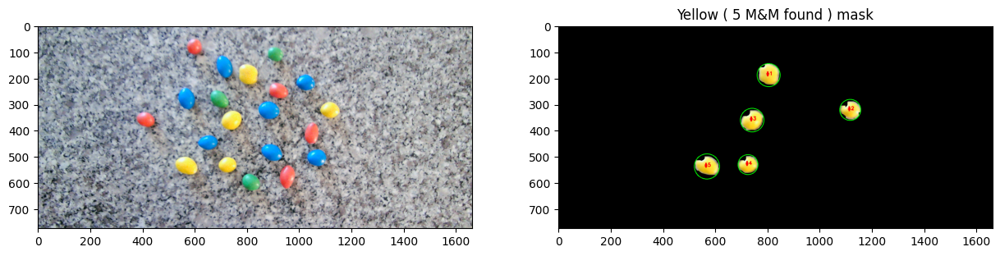

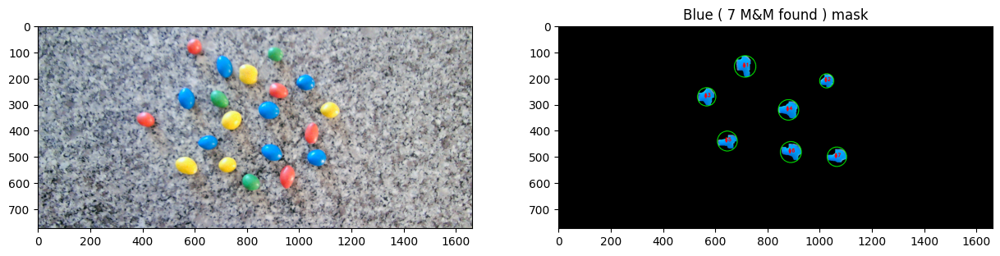

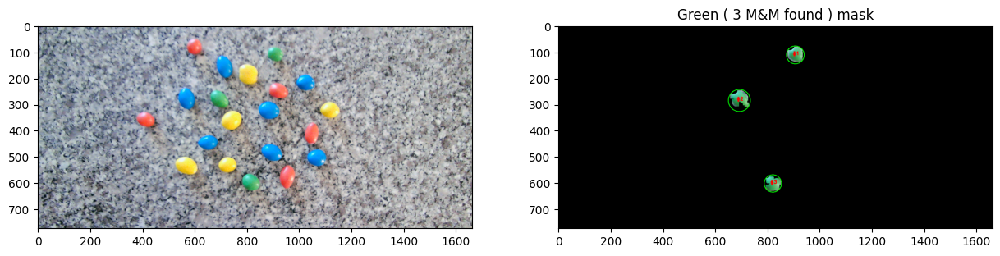

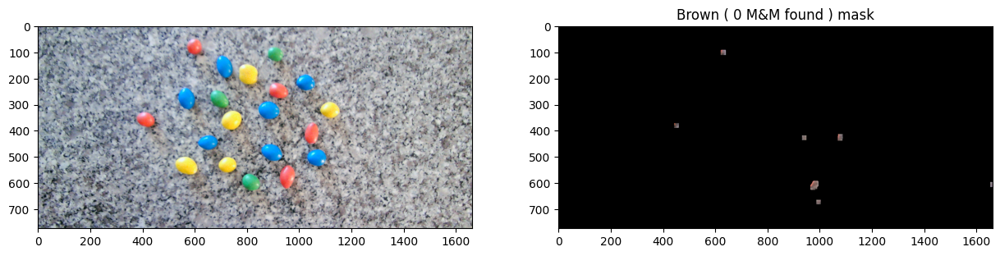

In [ ]:
for im in image_roi_total_g:
  mm, radis, colors = process(im.copy())
  for m, r, color in zip(mm, radis, colors):
    count = len(r)
    display(im, m, color=f"{color} ( {count} M&M found )")



---



d) III Determine the average area for peanuts in pixels, considering the image “calib_img 3



---



i. Show all peanuts that were detected.



---



1. **Image Undistortion**
2. **Noise Reduction with Median Blur**
3. **Color Space Conversion:** Converted from the BGR color space to the HSV color space to facilitate color-based segmentation
4. **Color-Based Segmentation**
5. **Binary Mask Creation**
6. **Contour Detection**
7. **Noise Contour Filtering:** Areas smaller than a predefined threshold (min_contour_area) are considered noise and are filtered out.
8. **Average Peanut Area Calculation**

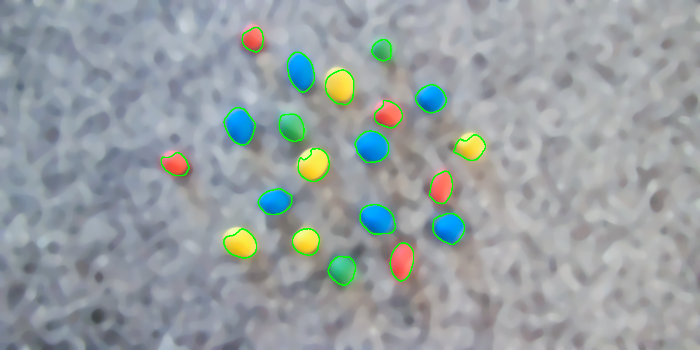


Visualization of Filtered Contours:
Green lines represent filtered contours.

Average Area of Peanuts in Pixels: 3285.72 square pixels
Total Number of Filtered Contours: 20


In [ ]:
#Load the distorted image
distorted_image_mm = '/content/gdrive/MyDrive/VC_Assign_1/GreyBackground/calib_img 3.png'

img = cv.imread(distorted_image_mm)

height, width, channels = img.shape

newcameramatrix, roi = cv.getOptimalNewCameraMatrix(mtx, dist,
(width, height), 1, (width, height))

# Undistort the image
undistorted_image = cv.undistort(img, mtx, dist, None, newcameramatrix)

x, y, w, h = roi
image_roi = undistorted_image[y:y+h, x:x+w]
image_roi = cv.medianBlur(src=image_roi, ksize=21)

# Apply median blur to reduce noise
image_roi = cv.medianBlur(image_roi, ksize=21)

# Convert the image to the HSV color space
hsv_image = cv.cvtColor(image_roi, cv.COLOR_BGR2HSV)

# Define a common color range for peanuts
color_range = (np.array([0, 100, 60]), np.array([180, 255, 255]))  # Adjust as needed

# Create a binary mask based on the color range
mask = cv.inRange(hsv_image, color_range[0], color_range[1])

# Find contours in the binary mask
contours, _ = cv.findContours(mask, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

# Filter out small contours (noise)
min_contour_area = 100  # Adjust as needed
filtered_contours = [contour for contour in contours if cv.contourArea(contour) > min_contour_area]

# Draw the filtered contours on the original image
output_image = image_roi.copy()
cv.drawContours(output_image, filtered_contours, -1, (0, 255, 0), 2)
# cv2_imshow(output_image)
img_prt = cv.resize(output_image, (700,350))
cv2_imshow(img_prt)

# Calculate the average area of peanuts in pixels
total_area = sum(cv.contourArea(contour) for contour in filtered_contours)
average_area = total_area / len(filtered_contours)

# Display the results with formatted output
print("")
print("Visualization of Filtered Contours:")
print("Green lines represent filtered contours.")
print("")

print(f"Average Area of Peanuts in Pixels: {average_area:.2f} square pixels")
print(f"Total Number of Filtered Contours: {len(filtered_contours)}")




---



ii) Discuss the limitations of the peanut detection method used
(in 2 sentences).



---





The peanut detection task can have the following limitations

*   Peanuts exposed to a brighter light are harder to detect as it reflex can have an white color
*   Without using ROI the noisy background interferes with the color ranges





---



d) IV Determine the average area for peanuts in pixels, considering the image “calib_img 3



---



i. Show the result in a table color vs area and standard
deviation.



---



/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:265: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:223: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:257: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


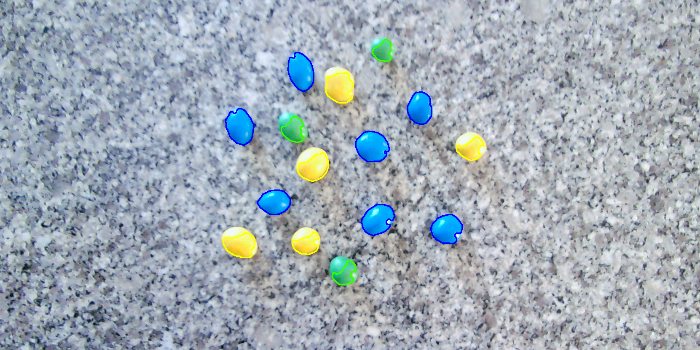

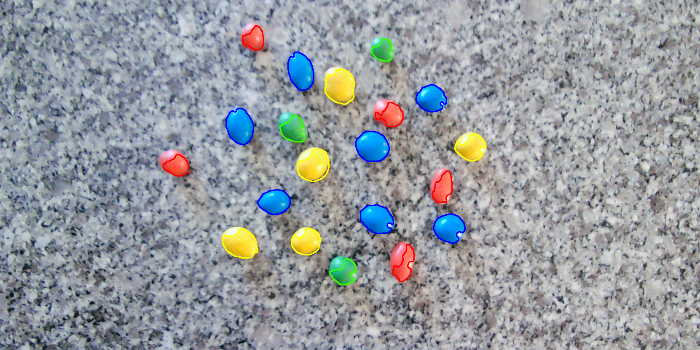

Picture: /content/gdrive/MyDrive/VC_Assign_1/GreyBackground/calib_img 2.png
╒═════════╤═══════════════════════╤═════════════════════════════╕
│ Color   │   Average Area (mm^2) │   Standard Deviation (mm^2) │
╞═════════╪═══════════════════════╪═════════════════════════════╡
│ red     │                  0    │                      nan    │
├─────────┼───────────────────────┼─────────────────────────────┤
│ blue    │                246.63 │                       22.75 │
├─────────┼───────────────────────┼─────────────────────────────┤
│ yellow  │                178.98 │                       41.24 │
├─────────┼───────────────────────┼─────────────────────────────┤
│ green   │                115.43 │                       15.34 │
╘═════════╧═══════════════════════╧═════════════════════════════╛
---
Picture: /content/gdrive/MyDrive/VC_Assign_1/GreyBackground/calib_img 3.png
╒═════════╤═══════════════════════╤═════════════════════════════╕
│ Color   │   Average Area (mm^2) │   Standard Devia

In [ ]:
# Directory path containing your image files
directory_path = '/content/gdrive/MyDrive/VC_Assign_1/GreyBackground/'

# Define the file patterns to match
pattern_2 = 'calib_img 2.png'
pattern_3 = 'calib_img 3.png'

# Use glob to find the file paths that match the patterns
file_paths_2 = glob.glob(directory_path + pattern_2)
file_paths_3 = glob.glob(directory_path + pattern_3)

# Define color ranges and corresponding color names
color_ranges = {
        "red": [
            (np.array([0, 100, 30]), np.array([10, 255, 255])),  # Original red range
            #(np.array([170, 100, 60]), np.array([180, 255, 255]))
        ],
        "blue": [
            (np.array([90, 150, 130]), np.array([130, 255, 255])),
        ],
        "yellow": [
            (np.array([15, 100, 60]), np.array([35, 255, 255])),
        ],
        "green": [
            (np.array([40, 100, 80]), np.array([80, 255, 255])),
        ]
    }


# Initialize a dictionary to store results for each color in this picture
picture_results = {}

# Define colors for drawing contours
contour_colors = {
    "red": (0, 0, 255),    # Red color
    "blue": (255, 0, 0),   # Blue color
    "yellow": (0, 255, 255),  # Yellow color
    "green": (0, 255, 50),  # Green color
}

# Define a kernel for morphological closing
kernel = np.ones((5, 5), np.uint8)

# Loop through the defined color ranges
for file_path in file_paths_2 + file_paths_3:
    img = cv.imread(file_path)

    height, width, channels = img.shape

    newcameramatrix, roi = cv.getOptimalNewCameraMatrix(mtx, dist,
                                                      (width, height), 1, (width, height))

    # Undistort the image
    undistorted_image = cv.undistort(img, mtx, dist, None, newcameramatrix)

    x, y, w, h = roi
    image_roi = undistorted_image[y:y + h, x:x + w]

    # Apply median blur to reduce noise
    bluring = cv.medianBlur(src=image_roi, ksize=21)
    blurred_image = cv.GaussianBlur(src=image_roi, ksize=(9, 9), sigmaX=10, sigmaY=10)

    # Convert the image to the HSV color space
    hsv_image = cv.cvtColor(blurred_image, cv.COLOR_BGR2HSV)

    # Store the color results for each picture
    picture_results[file_path] = {}

    for color_name, color_range in color_ranges.items():
        total_area = 0  # Initialize the total area for this color range
        color_contours = []
        color_areas = []

        for color_instance in color_range:
            # Create a binary mask based on the color range
            mask = cv.inRange(hsv_image, color_instance[0], color_instance[1])
            mask = cv.erode(mask, kernel, iterations=1)

            # Dilation to connect nearby regions
            mask = cv.dilate(mask, kernel, iterations=1)
            # Find contours in the binary mask
            contours, _ = cv.findContours(mask, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

            # Filter out small contours (noise)
            min_contour_area = 200  # Adjust as needed
            filtered_contours = [contour for contour in contours if cv.contourArea(contour) > min_contour_area]

            # Calculate the area of each filtered contour
            areas = [cv.contourArea(contour) * ((1/px_mm_ratio) ** 2) for contour in filtered_contours]

            # Sum the areas of filtered contours for this color range
            total_area += sum(areas)

            # Add the filtered contours to the list
            color_contours.extend(filtered_contours)
            color_areas.extend(areas)

            # Draw small contours as circles
            for contour in filtered_contours:
                if cv.contourArea(contour) < 1200:  # Adjust the threshold as needed
                    (x, y), radius = cv.minEnclosingCircle(contour)
                    center = (int(x), int(y))
                    radius = int(radius * 2)  # Adjust the expansion factor as needed
                    cv.circle(image_roi, center, radius, contour_colors[color_name], 5)  # Adjust the line thickness as needed
                else:
                    # For larger contours, draw as is
                    cv.drawContours(image_roi, [contour], -1, contour_colors[color_name], 2)

        # Calculate the average area for this color range
        if color_areas:
            average_area = total_area / len(color_areas)
        else:
            average_area = 0

        # Store the average area and standard deviation for this color range in this picture
        picture_results[file_path][color_name] = {
            "Average Area (mm^2)": average_area,
            "Standard Deviation (mm^2)": np.std(color_areas)
        }

    # Display the image for this picture
    img_prt = cv.resize(image_roi, (700,350))
    cv2_imshow(img_prt)

# Output results for each picture
for file_path, color_results in picture_results.items():
    table_data = []
    table_headers = ["Color", "Average Area (mm^2)", "Standard Deviation (mm^2)"]

    print(f'Picture: {file_path}')

    for color_name, results in color_results.items():
        average_area = results["Average Area (mm^2)"]
        std_deviation = results["Standard Deviation (mm^2)"]
        table_data.append([color_name, f'{average_area:.2f}', f'{std_deviation:.2f}'])

    # Print the table using tabulate
    print(tabulate(table_data, headers=table_headers, tablefmt="fancy_grid"))
    print('---')



---



ii) Discuss the limitations of the peanut detection method used
(in 2 sentences).



---



There are a few limitations with this procedure:
*   Having a noise background turns the identification harder, speacially in some areas of the red peanuts as they can have a simmilar color of the background (depending on the ranges and filters).
*   The images have different bright, one of them is too bright, which makes the color range set up harder



---



### Alternative approach

1. **Noise Reduction and Blurring:** We start by reducing noise in the image using a median filter and further applies Gaussian blurring for smoother results.

2. **Color Ranges:**  It defines color ranges for different peanut colors in the LAB color space, specifying the minimum and maximum values for each color component.

3. **Image Preprocessing:** The image is converted to the LAB color space for color matching and analysis.

4. **Mask Generation:** For each defined color range, a binary mask is created to isolate the pixels that match that color.

5. **Morphological Operations:** Morphological closing is applied to the binary mask using a defined kernel to remove noise and gaps in the peanut shapes.

6. **Contour Detection:** Contours are identified in the binary mask, and small contours (likely noise) are filtered out based on a minimum contour area threshold.

7. **Color Count Increment:** The count of peanuts of the current color is incremented based on the number of filtered contours.

8. **Combined Mask:** A combined binary mask is generated by applying bitwise OR to all the individual color masks.

9. **Connected Components Analysis:** The function performs connected components analysis on the combined mask to identify individual peanut-like regions.

Image 1 has:
5 peanuts of Red color
7 peanuts of Blue color
5 peanuts of Yellow color
3 peanuts of Green color
5 peanuts of Brown color


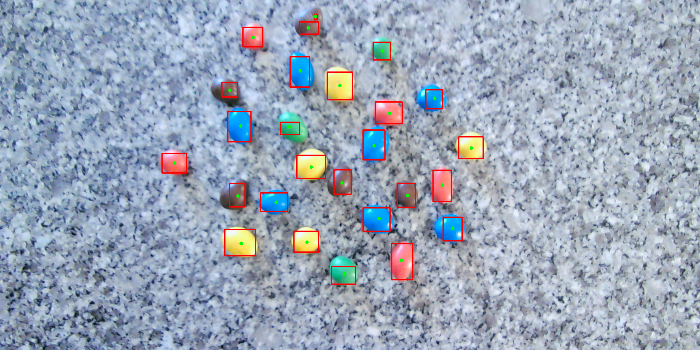

Image 2 has:
0 peanuts of Red color
7 peanuts of Blue color
5 peanuts of Yellow color
3 peanuts of Green color
0 peanuts of Brown color


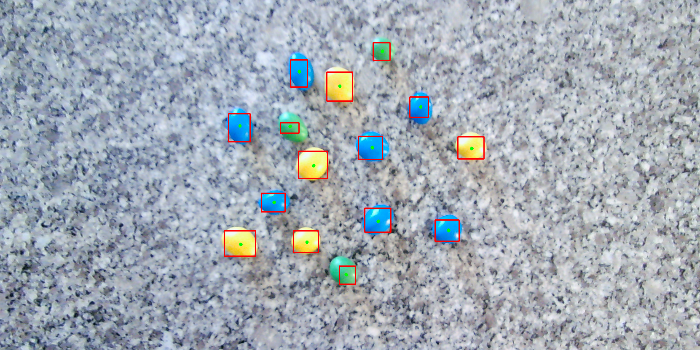

Image 3 has:
4 peanuts of Red color
6 peanuts of Blue color
4 peanuts of Yellow color
3 peanuts of Green color
5 peanuts of Brown color


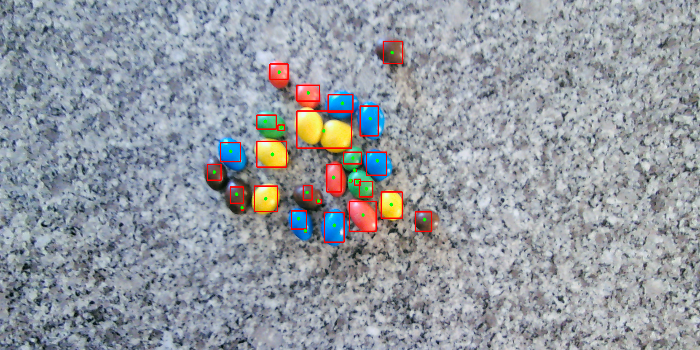

Image 4 has:
0 peanuts of Red color
7 peanuts of Blue color
5 peanuts of Yellow color
0 peanuts of Green color
0 peanuts of Brown color


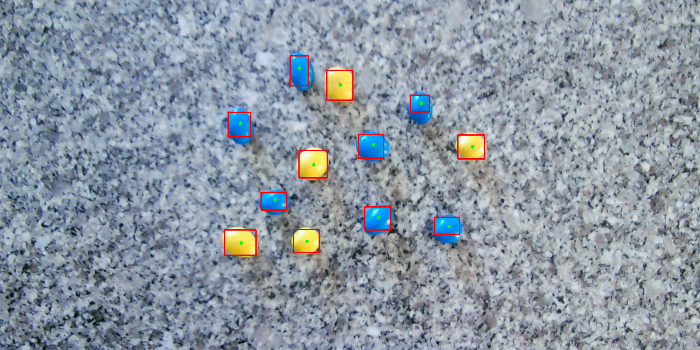

Image 5 has:
0 peanuts of Red color
0 peanuts of Blue color
0 peanuts of Yellow color
0 peanuts of Green color
0 peanuts of Brown color


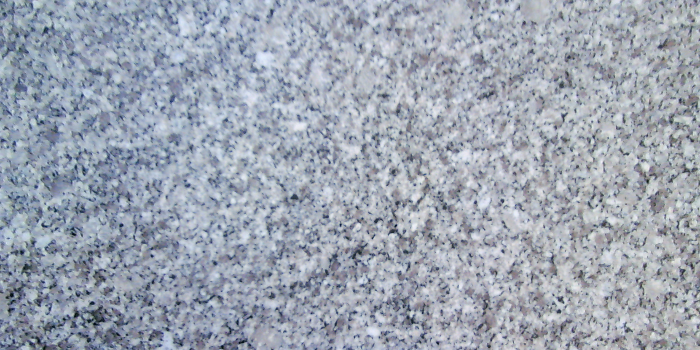

Image 6 has:
5 peanuts of Red color
7 peanuts of Blue color
5 peanuts of Yellow color
3 peanuts of Green color
0 peanuts of Brown color


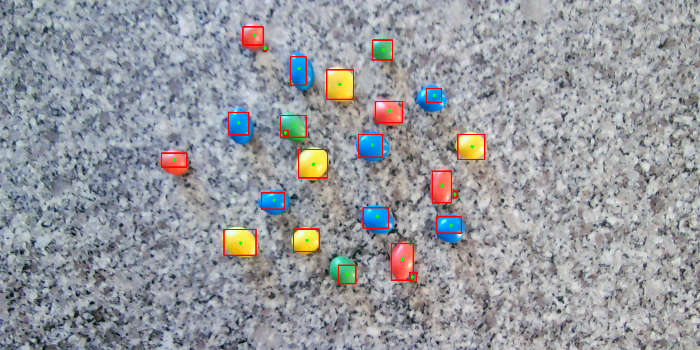

In [ ]:
def count_peanuts_in_image(image):
    # Reduce the amount of noise in the background
    medianB = cv.medianBlur(image.copy(), ksize=11)
    blurred_image = cv.GaussianBlur(medianB, (7, 7), 10, 10)

    # Define color ranges for M&M colors
    color_ranges =  {
        "red": [
            (np.array([130, 155, 110]), np.array([220, 195, 170])),
        ],
        "blue": [
            (np.array([130, 110, 60]), np.array([180, 150, 80])),
        ],
        "yellow": [
            (np.array([180, 100, 160]), np.array([250, 135, 220])),
        ],
        "green": [
            (np.array([100, 80, 110]), np.array([200, 100, 170])),
        ],
        "brown": [
            (np.array([60, 133, 120]), np.array([139, 147, 144]))]
        }


    lab_image = cv.cvtColor(blurred_image, cv.COLOR_BGR2LAB)
    # Define a minimum contour area to filter out small noise
    min_contour_area = 150  # Adjust as needed

    color_counts = {color: 0 for color in color_ranges}

    # Initialize a binary mask to combine results
    combined_mask = np.zeros_like(lab_image[:, :, 0])

    # Loop through the defined color ranges
    for color, ranges in color_ranges.items():
        for color_range in ranges:
            # Create a mask for the specified color range
            mask = cv.inRange(lab_image, color_range[0], color_range[1])

            # Apply erose and dilate to the  mask
            kerneler = np.ones((11,11), 'uint8')
            mask= cv.erode(mask, kerneler, iterations=1)
            kerneld = np.ones((3,3), 'uint8')
            mask = cv.dilate(mask, kerneld, iterations=2)

            # Find contours in the binary mask
            contours, _ = cv.findContours(mask, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

            # Filter out small contours (noise)
            filtered_contours = [contour for contour in contours if cv.contourArea(contour) > min_contour_area]

            # Increment the color count for each detected M&M of the current color
            color_counts[color] += len(filtered_contours)

            # Apply bitwise OR to the combined mask
            combined_mask = cv.bitwise_or(combined_mask, mask)

    # Perform connected components analysis on the combined mask
    num_labels, labels, stats, centroids = cv.connectedComponentsWithStats(combined_mask, connectivity=8, ltype=cv.CV_32S)

    # Iterate through the connected components
    for label in range(1, num_labels):  # Skip the background (label 0)
        # Extract statistics for the current component
        left, top, width, height, area = stats[label]

        # Draw a bounding box around the component
        cv.rectangle(image, (left, top), (left + width, top + height), (0, 0, 255), 2)

        # Draw the centroid of the component
        centroid_x, centroid_y = centroids[label]
        cv.circle(image, (int(centroid_x), int(centroid_y)), 4, (0, 255, 0), -1)

    return image, color_counts

# Load your images using glob or any other method you prefer
image_paths = image_roi_total_g

# Count peanuts for each image and print the results
for i, image_path in enumerate(image_paths):
    image = image_path.copy()
    image_with_contours, color_counts = count_peanuts_in_image(image)

    print(f"Image {i + 1} has:")
    for color, count in color_counts.items():
        print(f"{count} peanuts of {color.capitalize()} color")
    # cv2_imshow(image)
    img_prt = cv.resize(image, (700,350))
    cv2_imshow(img_prt)


## References


https://towardsdatascience.com/what-are-intrinsic-and-extrinsic-camera-parameters-in-computer-vision-7071b72fb8ec

https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html

https://www.youtube.com/watch?v=qByYk6JggQU

https://www.youtube.com/watch?v=GUbWsXU1mac

https://www.youtube.com/watch?v=2XM2Rb2pfyQ&t=35s

https://medium.com/@VK_Venkatkumar/background-removal-general-pixel-wise-vs-deep-learning-approach-4f919fe3dd3a

https://pyimagesearch.com/2015/11/02/watershed-opencv/

# Annex

Cool stuff we found while working for this project

## Rembg library

Rembg is Deeplearning approach.
Rembg is backbone architecture — U2Net.

Effortly removes background from pictures.*italicized text*

In [ ]:
!pip install rembg

from rembg import remove

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.2/6.2 MB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.1 MB/s eta 0:00:00


In [ ]:
img = image_roi_total_g[0].copy()

In [ ]:
output = remove(img)


  0%|                                               | 0.00/176M [00:00<?, ?B/s]
  0%|                                       | 81.9k/176M [00:00<03:43, 787kB/s]
  0%|▏                                      | 802k/176M [00:00<00:40, 4.35MB/s]
  1%|▍                                     | 1.87M/176M [00:00<00:25, 6.90MB/s]
  2%|▌                                     | 2.65M/176M [00:00<00:24, 7.21MB/s]
  2%|▊                                     | 3.57M/176M [00:00<00:22, 7.80MB/s]
  3%|█                                     | 4.99M/176M [00:00<00:17, 9.73MB/s]
  3%|█▎                                    | 5.97M/176M [00:00<00:17, 9.75MB/s]
  4%|█▌                                    | 7.13M/176M [00:00<00:16, 10.3MB/s]
  5%|██                                    | 9.43M/176M [00:00<00:11, 14.2MB/s]
  7%|██▍                                   | 11.6M/176M [00:01<00:10, 16.1MB/s]
  7%|██▊                                   | 13.2M/176M [00:01<00:10, 16.1MB/s]
  9%|███▎                              

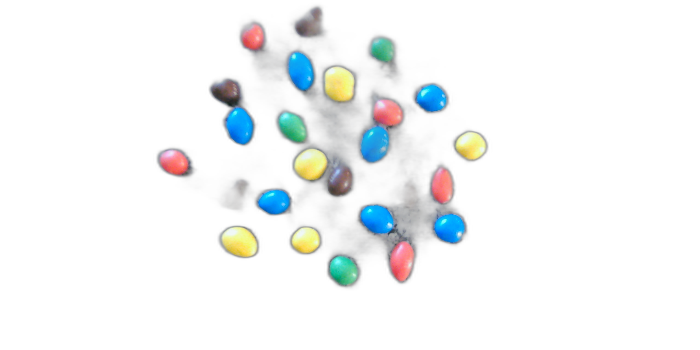

In [ ]:
img_prt = cv.resize(output, (700,350))
cv2_imshow(img_prt)

## Extracting colours from image with k-means

In [ ]:
import sklearn
from sklearn.cluster import KMeans
from collections import Counter
from skimage.color import rgb2lab, deltaE_cie76
import cv2
plt.style.use('ggplot')
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.serif'] = 'Ubuntu'
plt.rcParams['font.monospace'] = 'Ubuntu Mono'
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 12
plt.rcParams['image.cmap'] = 'jet'
plt.rcParams['image.interpolation'] = 'none'
plt.rcParams['figure.figsize'] = (10, 10
                                 )
plt.rcParams['axes.grid']=False
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['lines.markersize'] = 8
colors = ['xkcd:pale orange', 'xkcd:sea blue', 'xkcd:pale red', 'xkcd:sage green', 'xkcd:terra cotta', 'xkcd:dull purple', 'xkcd:teal', 'xkcd: goldenrod', 'xkcd:cadet blue',
'xkcd:scarlet']

In [ ]:
image_color = image_roi_total_g[4].copy()

In [ ]:
def RGB2HEX(color):
    return "#{:02x}{:02x}{:02x}".format(int(color[0]), int(color[1]), int(color[2]))

In [ ]:
number_of_colors = 20
modified_image = image_color.reshape(image_color.shape[0]*image_color.shape[1], 3)
clf = KMeans(n_clusters = number_of_colors)
labels = clf.fit_predict(modified_image)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
counts = Counter(labels)

center_colors = clf.cluster_centers_
# We get ordered colors by iterating through the keys
ordered_colors = [center_colors[i] for i in counts.keys()]
hex_colors = [RGB2HEX(ordered_colors[i]) for i in counts.keys()]
rgb_colors = [ordered_colors[i] for i in counts.keys()]

([<matplotlib.patches.Wedge at 0x7a2227455a50>,
 [Text(1.0959778210840598, 0.09398199663678562, '#b0aaa5'),
  Text(1.0572156529508983, 0.30380102559999006, '#705a51'),
  Text(0.942888597490564, 0.566534282036204, '#b6a397'),
  Text(0.7549055553056103, 0.8000734982292117, '#d6cfc8'),
  Text(0.5127781396202404, 0.9731693478154794, '#827671'),
  Text(0.17148929033911814, 1.086550239657139, '#8f8581'),
  Text(-0.11085079702471365, 1.0944003384497767, '#967b6f'),
  Text(-0.4234469371948891, 1.015230363700903, '#e3dad5'),
  Text(-0.8239838809929233, 0.7287321619524146, '#cec6be'),
  Text(-1.061597012705761, 0.2881176541175575, '#bab4af'),
  Text(-1.0730248525768509, -0.24211085426396636, '#9b928e'),
  Text(-0.8011647362775415, -0.7537473484831224, '#81695f'),
  Text(-0.34452618608709257, -1.044653869518647, '#a69f9a'),
  Text(0.10436098567163078, -1.0950382571717054, '#5e473d'),
  Text(0.5784100813692872, -0.9356504570459926, '#beaea3'),
  Text(0.9331314431409145, -0.5824652005242499, '#402f

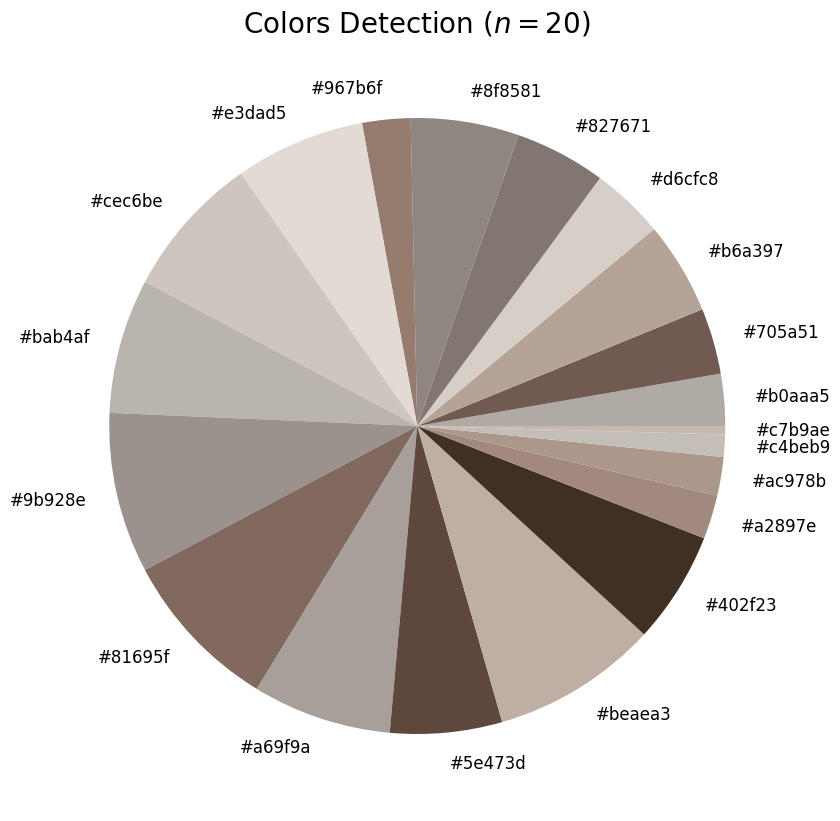

In [ ]:
plt.title('Colors Detection ($n=20$)', fontsize=20)
plt.pie(counts.values(), labels = hex_colors, colors = hex_colors)